# Architecture of Camera Radar Fusion Tracking
![Architecture of Camera Radar Fusion Tracking](../media/architecture_of_camerar_radar_tracking.png)

In [88]:
# importing libraries
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from nuscenes.utils.data_classes import RadarPointCloud, view_points
from pyquaternion import Quaternion
from sklearn.cluster import DBSCAN
from PIL import Image
from copy import deepcopy
import matplotlib.patches as patches

from sort import Sort

%matplotlib inline

In [384]:
# instance of sort
mot_tracker = Sort() 

In [385]:
!ls | grep jpg

n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151603512404.jpg
n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151604012404.jpg
n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151604512404.jpg
n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151605012404.jpg


In [386]:
# read image
im1 = Image.open('n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151603512404.jpg')
im2 = Image.open('n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151604012404.jpg')
im3 = Image.open('n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151604512404.jpg')
im4 = Image.open('n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151605012404.jpg')


In [117]:
!ls | grep .pcd

n008-2018-08-01-15-16-36-0400__RADAR_FRONT__1533151603555991.pcd
n008-2018-08-01-15-16-36-0400__RADAR_FRONT__1533151604069888.pcd
n008-2018-08-01-15-16-36-0400__RADAR_FRONT__1533151604579949.pcd
n008-2018-08-01-15-16-36-0400__RADAR_FRONT__1533151605015872.pcd


In [78]:
pc1 = RadarPointCloud.from_file('n008-2018-08-01-15-16-36-0400__RADAR_FRONT__1533151603555991.pcd')
pc2 = RadarPointCloud.from_file('n008-2018-08-01-15-16-36-0400__RADAR_FRONT__1533151604069888.pcd')
pc3 = RadarPointCloud.from_file('n008-2018-08-01-15-16-36-0400__RADAR_FRONT__1533151604579949.pcd')
pc4 = RadarPointCloud.from_file('n008-2018-08-01-15-16-36-0400__RADAR_FRONT__1533151605015872.pcd')


In [81]:
pc = pc1
cs_record = {'token': 'f4d2a6c281f34a7eb8bb033d82321f79', 'sensor_token': '47fcd48f71d75e0da5c8c1704a9bfe0a', 'translation': [3.412, 0.0, 0.5], 'rotation': [0.9999984769132877, 0.0, 0.0, 0.0017453283658983088], 'camera_intrinsic': []}
pc.rotate(Quaternion(cs_record['rotation']).rotation_matrix)
pc.translate(np.array(cs_record['translation']))

# Second step: transform from ego to the global frame.
# poserecord = self.nusc.get('ego_pose', pointsensor['ego_pose_token'])
poserecord1 = {'token': 'b70cefb08263499eb30c7e7da0031428', 'timestamp': 1532402928114656, 'rotation': [0.5742482223921863, -0.00183950588546914, 0.014160690493351492, -0.8185566994058888], 'translation': [409.8439847252494, 1176.9519903782593, 0.0]}
pc.rotate(Quaternion(poserecord1['rotation']).rotation_matrix)
pc.translate(np.array(poserecord1['translation']))

# Third step: transform from global into the ego vehicle frame for the timestamp of the image.
# poserecord = self.nusc.get('ego_pose', cam['ego_pose_token'])
poserecord2 = {'token': '4b6870ae200c4b969b91c50a9737f712', 'timestamp': 1532402928112460, 'rotation': [0.5742377826385253, -0.0018667925555496464, 0.014165885989800115, -0.8185638715152707], 'translation': [409.8506686425138, 1176.9702106041582, 0.0]}
pc.translate(-np.array(poserecord2['translation']))
pc.rotate(Quaternion(poserecord2['rotation']).rotation_matrix.T)

# Fourth step: transform from ego into the camera.
# cs_record = self.nusc.get('calibrated_sensor', cam['calibrated_sensor_token'])
cs_record = {'token': '1d31c729b073425e8e0202c5c6e66ee1', 'sensor_token': '725903f5b62f56118f4094b46a4470d8', 'translation': [1.70079118954, 0.0159456324149, 1.51095763913], 'rotation': [0.4998015430569128, -0.5030316162024876, 0.4997798114386805, -0.49737083824542755], 'camera_intrinsic': [[1266.417203046554, 0.0, 816.2670197447984], [0.0, 1266.417203046554, 491.50706579294757], [0.0, 0.0, 1.0]]}
pc.translate(-np.array(cs_record['translation']))
pc.rotate(Quaternion(cs_record['rotation']).rotation_matrix.T)

In [83]:
pc1.points[1,:]

array([0.98959228, 0.98735175, 0.98175041, 0.97614908, 0.97227402,
       0.96561278, 0.97449041, 0.97663919, 0.94484921, 0.93408596,
       0.9201961 , 0.93605849, 0.94320261, 0.92572499, 0.92081417,
       0.91073177, 0.90219215, 0.90573161, 0.91652867, 0.88607382,
       0.88843026, 0.87781669, 0.88882379, 0.87324387, 0.86403548,
       0.88543643, 0.84762984, 0.85740562, 0.85678271, 0.84352783,
       0.83558214, 0.84181363, 0.84086478, 0.84419661, 0.83145599,
       0.8246185 , 0.85634571, 0.83635233, 0.78282578, 0.81787999,
       0.78862993, 0.78948703, 0.80049414, 0.78466312, 0.80323686,
       0.76739314, 0.76698269, 0.78687951, 0.76417961, 0.76182803,
       0.76974474, 0.77636252, 0.75710793, 0.75339947, 0.75652606,
       0.74806612, 0.73810686, 0.76807399, 0.76824541, 0.73945408,
       0.7312935 , 0.7496572 , 0.75609389, 0.71900678, 0.79169376,
       0.70552737, 0.73101344, 0.69249461, 0.75911428, 0.71343201,
       0.6783778 , 0.70515556, 0.74327602, 0.68715162])

In [84]:
pc.points[1,:]

array([0.98959228, 0.98735175, 0.98175041, 0.97614908, 0.97227402,
       0.96561278, 0.97449041, 0.97663919, 0.94484921, 0.93408596,
       0.9201961 , 0.93605849, 0.94320261, 0.92572499, 0.92081417,
       0.91073177, 0.90219215, 0.90573161, 0.91652867, 0.88607382,
       0.88843026, 0.87781669, 0.88882379, 0.87324387, 0.86403548,
       0.88543643, 0.84762984, 0.85740562, 0.85678271, 0.84352783,
       0.83558214, 0.84181363, 0.84086478, 0.84419661, 0.83145599,
       0.8246185 , 0.85634571, 0.83635233, 0.78282578, 0.81787999,
       0.78862993, 0.78948703, 0.80049414, 0.78466312, 0.80323686,
       0.76739314, 0.76698269, 0.78687951, 0.76417961, 0.76182803,
       0.76974474, 0.77636252, 0.75710793, 0.75339947, 0.75652606,
       0.74806612, 0.73810686, 0.76807399, 0.76824541, 0.73945408,
       0.7312935 , 0.7496572 , 0.75609389, 0.71900678, 0.79169376,
       0.70552737, 0.73101344, 0.69249461, 0.75911428, 0.71343201,
       0.6783778 , 0.70515556, 0.74327602, 0.68715162])

In [82]:
print(pc.points[2,:])

[ 4.5255394   4.92553228  5.925514    6.92549596  7.52678348  6.75492022
  7.91552689  7.71293477 13.11673086 11.96088339 14.95347416 14.71626973
 13.71239389 16.31970248 14.36040802 16.16037479 17.95644958 19.91920527
 14.37122436 20.95466485 19.5685335  24.72171385 23.51091839 25.71909989
 24.16498967 19.37892194 28.14977464 25.16756756 28.71818047 27.76579043
 29.75753393 27.77011696 27.96968147 31.11597353 30.16228552 32.34840168
 23.39572329 26.99522608 39.74913313 36.90029452 40.52315871 40.52099544
 39.31019998 41.32184555 39.30327751 42.74561778 42.15514852 41.71059086
 44.1339124  42.56249413 44.31703225 43.70882417 42.77157701 46.32997579
 42.1815404  44.17458186 47.55158759 45.70143298 45.70100033 48.33686217
 48.94896794 42.59321255 47.90052875 49.9658234  32.82583912 53.54888344
 52.49871364 56.53931095 38.82313497 55.69779138 58.54662999 57.29603037
 52.27059399 60.29900483]


In [393]:
type(pc1)

nuscenes.utils.data_classes.RadarPointCloud

In [533]:
def calibrate_radar_points(pc: RadarPointCloud) -> tuple[np.ndarray, np.ndarray]:
    # Points live in the point sensor frame. So they need to be transformed via global to the image plane.
    # First step: transform the pointcloud to the ego vehicle frame for the timestamp of the sweep.
    # cs_record = self.nusc.get('calibrated_sensor', pointsensor['calibrated_sensor_token'])
    cs_record = {'token': 'f4d2a6c281f34a7eb8bb033d82321f79', 'sensor_token': '47fcd48f71d75e0da5c8c1704a9bfe0a', 'translation': [3.412, 0.0, 0.5], 'rotation': [0.9999984769132877, 0.0, 0.0, 0.0017453283658983088], 'camera_intrinsic': []}
    pc.rotate(Quaternion(cs_record['rotation']).rotation_matrix)
    pc.translate(np.array(cs_record['translation']))

    # Second step: transform from ego to the global frame.
    # poserecord = self.nusc.get('ego_pose', pointsensor['ego_pose_token'])
    poserecord1 = {'token': 'b70cefb08263499eb30c7e7da0031428', 'timestamp': 1532402928114656, 'rotation': [0.5742482223921863, -0.00183950588546914, 0.014160690493351492, -0.8185566994058888], 'translation': [409.8439847252494, 1176.9519903782593, 0.0]}
    pc.rotate(Quaternion(poserecord1['rotation']).rotation_matrix)
    pc.translate(np.array(poserecord1['translation']))

    # Third step: transform from global into the ego vehicle frame for the timestamp of the image.
    # poserecord = self.nusc.get('ego_pose', cam['ego_pose_token'])
    poserecord2 = {'token': '4b6870ae200c4b969b91c50a9737f712', 'timestamp': 1532402928112460, 'rotation': [0.5742377826385253, -0.0018667925555496464, 0.014165885989800115, -0.8185638715152707], 'translation': [409.8506686425138, 1176.9702106041582, 0.0]}
    pc.translate(-np.array(poserecord2['translation']))
    pc.rotate(Quaternion(poserecord2['rotation']).rotation_matrix.T)

    # Fourth step: transform from ego into the camera.
    # cs_record = self.nusc.get('calibrated_sensor', cam['calibrated_sensor_token'])
    cs_record = {'token': '1d31c729b073425e8e0202c5c6e66ee1', 'sensor_token': '725903f5b62f56118f4094b46a4470d8', 'translation': [1.70079118954, 0.0159456324149, 1.51095763913], 'rotation': [0.4998015430569128, -0.5030316162024876, 0.4997798114386805, -0.49737083824542755], 'camera_intrinsic': [[1266.417203046554, 0.0, 816.2670197447984], [0.0, 1266.417203046554, 491.50706579294757], [0.0, 0.0, 1.0]]}
    pc.translate(-np.array(cs_record['translation']))
    pc.rotate(Quaternion(cs_record['rotation']).rotation_matrix.T)

    # Fifth step: actually take a "picture" of the point cloud.
    # Grab the depths (camera frame z axis points away from the camera).
    depths = pc.points[2, :]
    # print('depth', depths)
    # retreive the color from depth
    coloring = depths

    # Take the actual picture (matrix multiplication with camera-matrix + renormalization).
    points_with_depth = view_points(pc.points[:3, :], np.array(cs_record['camera_intrinsic']), normalize=False)
    points = view_points(pc.points[:3, :], np.array(cs_record['camera_intrinsic']), normalize=True)
    # print(points.shape)
    # print(points_with_depth.shape)
    # for i in range(10):
    #     print('x: ', int(points.T[i][0]), ' y: ', int(points.T[i][1]), ' z: ', int(points.T[i][2]))

    # print('-----')
    # for i in range(10):
    #     print('x: ', int(points_with_depth.T[i][0]), ' y: ', int(points_with_depth.T[i][1]), ' z: ', int(points_with_depth.T[i][2]))


    # Remove points that are either outside or behind the camera. Leave a margin of 1 pixel for aesthetic reasons.
    # Also make sure points are at least 1m in front of the camera to avoid seeing the lidar points on the camera
    # casing for non-keyframes which are slightly out of sync.
    min_dist : float = 1.0
    dot_size : int = 5
    mask = np.ones(depths.shape[0], dtype=bool)
    mask = np.logical_and(mask, depths > min_dist)
    mask = np.logical_and(mask, points[0, :] > 1)
    mask = np.logical_and(mask, points[0, :] < im1.size[0] - 1)
    mask = np.logical_and(mask, points[1, :] > 1)
    mask = np.logical_and(mask, points[1, :] < im1.size[1] - 1)
    points = points[:, mask]
    coloring = coloring[mask]
    return points, coloring

In [450]:
pc2.points.shape

(114, 3)

In [454]:
cleaned_data.T.shape

(3, 114)

In [452]:
pc3.points.shape

(18, 76)

In [455]:
pc5 = pc2
pc5.points = cleaned_data.T
points5, coloring5 = calibrate_radar_points(pc5)

depth [ 15.22792338 -12.40037525   7.46506927   6.63565563   6.03359146
  11.23217719  10.61425546  -6.39183441  10.80873935  12.6121736
   9.20323429  -9.59594919  -7.01251296 -13.40764412   8.17428461
  13.1783874    9.3708291  -11.82351168  -4.83734785 -12.23591849
 -14.23590495 -14.03659594  -4.25183023   7.31982414   8.31981738
   7.91706271  13.11564843   4.09985227  -5.90421668  -4.70905107
  18.47838178  18.86734767  19.66182789  18.25149616  10.22666845
  11.61424869   9.00599359  -7.39596428 -12.80626893 -13.00902514
 -13.80833048   8.97565826 -11.81799616  12.37425599  -4.83596897
 -13.03729215  15.14045471  15.53700442  17.3383713    7.72533704
   8.72257252   8.11775059  16.31562658  16.90941795  -6.299388
  17.0901121   18.88665196  18.08114263  18.47562403  19.87078809
  16.06392019  18.86045327  18.84597505  10.23701004  10.43425074
  10.43080354  11.81493753   7.00324937  12.01079936   8.39979232
  12.20597173 -12.40144594  -5.61528057 -11.42144645  15.16389564
  16.96

In [429]:
points1, coloring1 = calibrate_radar_points(pc1)
points2, coloring2 = calibrate_radar_points(pc2)
points3, coloring3 = calibrate_radar_points(pc3)
points4, coloring4 = calibrate_radar_points(pc4)

depth [ 25.79101652  26.84432022  24.0454634    7.73960841  22.19448923
  27.43974527  15.14124198   2.11067514  30.77158835   1.83830014
   1.06415766  23.22924278   2.78618325  26.56108604   9.23993329
   1.07773104 -11.47052313  25.18156532  31.36791657  13.97256261
  28.42653826  28.73013196   9.26617484  30.55079175  25.37385613
  20.68601902   3.95259967   0.62075564  21.60268325  18.55588333
  20.8783103   42.14347275  -4.17250262  -4.53762884  -9.96929526
  12.47495169  28.94776039  -8.33413886  29.37532625   6.14607751
 -12.87357249 -17.41979432 -15.46837511   6.60486224  -3.35356711
  29.05408594  10.36427118  30.74489171  36.29962507  29.80379603
  30.05173846  31.30909712  27.35830224  24.49112479  30.03997406
   7.67173924  17.81567422  29.65041415  26.87010779  29.80560613
  30.70371983]
(3, 61)
(3, 61)
-----
depth [17.27562186 17.51592015 18.00759203 19.60806655 18.65509235 18.06403172
 19.64401189 20.42435456 17.78636029 20.52570321 20.58010716 18.91603726
 20.6815316  

In [81]:
%matplotlib inline

In [195]:
points1[1, :]

array([655.09680387, 569.43893318, 563.34379555, 555.13610615,
       549.09139576, 545.05786902, 536.47490902, 539.38361938,
       534.5058903 , 536.78866564, 529.64069316, 534.65121264,
       529.28955569, 529.98096267, 527.06766047, 529.89679476,
       529.57992062, 525.86578863, 526.4172244 , 523.79030066,
       516.44808868, 519.57668692, 516.15308398, 516.18118702,
       517.29578082, 515.55514173, 517.38869804, 514.24249287,
       514.54861844, 515.39830592, 513.43510591, 514.1747252 ,
       513.50352933, 514.00135307, 513.92416095, 512.10103404,
       514.22026246, 512.95296883, 511.16468968, 512.79090857,
       512.79586027, 510.88063134, 510.4272333 , 513.79650387,
       511.4970395 , 509.73077349, 508.19260517, 509.14117401,
       507.01816907, 507.72858094, 506.18099868, 507.09315664,
       509.51523188, 505.93882355])

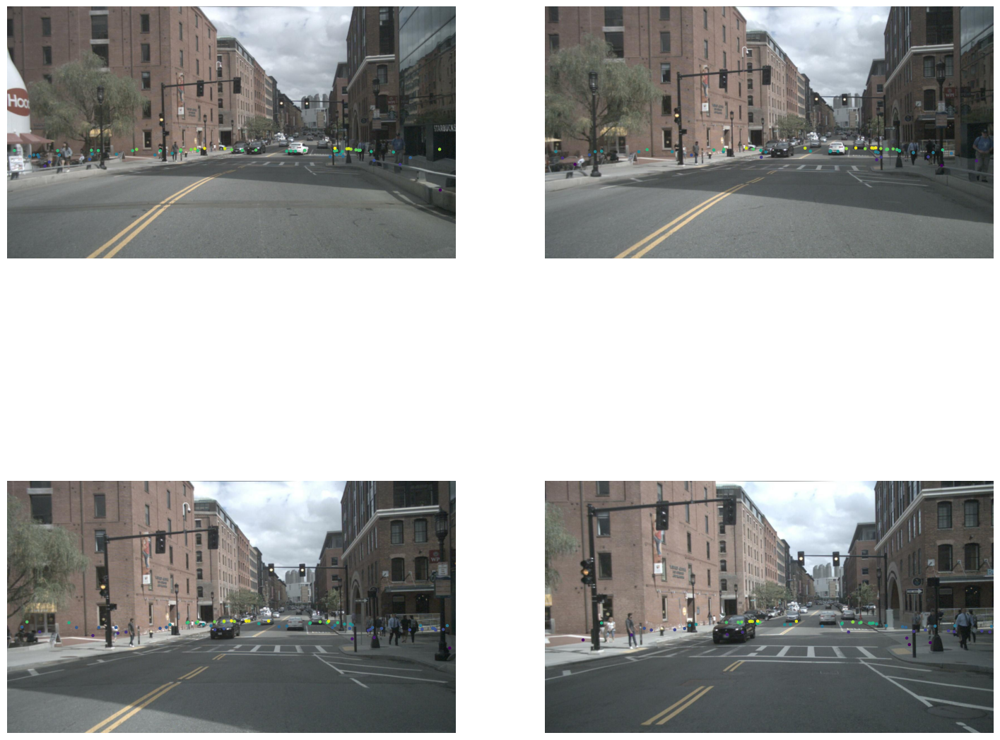

In [125]:
fig, ax = plt.subplots(2, 2, figsize=(18, 16))
# fig.canvas.set_window_title("sample token")
ax[0,0].imshow(im1)
ax[0,0].scatter(points1[0, :], points1[1, :], c=coloring1, s=5)
ax[0,0].axis('off')

ax[0,1].imshow(im2)
ax[0,1].scatter(points2[0, :], points2[1, :], c=coloring2, s=5)
ax[0,1].axis('off')

ax[1,0].imshow(im3)
ax[1,0].scatter(points3[0, :], points3[1, :], c=coloring3, s=5)
ax[1,0].axis('off')

ax[1,1].imshow(im4)
ax[1,1].scatter(cleaned_data[0, :], cleaned_data[1, :], c=cleaned_data[:,2], s=5)
ax[1,1].axis('off')



plt.show()

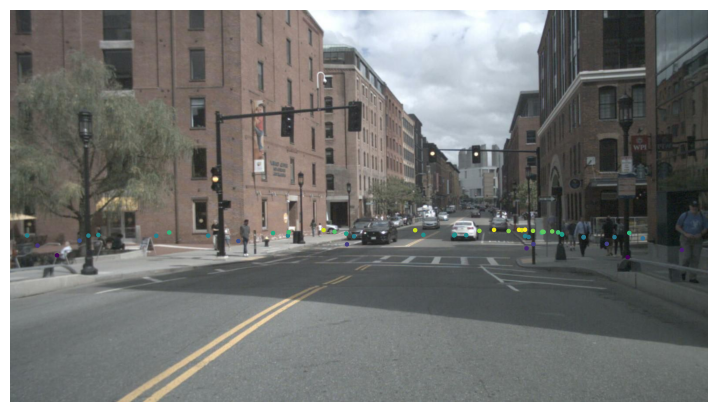

In [84]:
fig, ax = plt.subplots(1, 1, figsize=(9, 16))
# fig.canvas.set_window_title("sample token")
ax.imshow(im2)
ax.scatter(points[0, :], points[1, :], c=coloring, s=dot_size)
ax.axis('off')
plt.show()

# Radar Clustering with DBScan

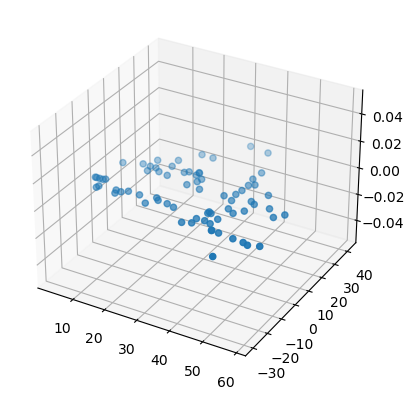

In [7]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(pc.points[0, :], pc.points[1, :], pc.points[2, :])
plt.show()

In [62]:
db_scan = DBSCAN(eps=3, min_samples=1)

In [65]:
output = db_scan.fit(pc.points[0:3, :])

In [66]:
output.labels_

array([0, 1, 2])

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(pc.points[0, :], pc.points[1, :], pc.points[2, :])
plt.show()

In [21]:
points = pc.points[:3, :]

In [24]:
# prepare model
model = DBSCAN(eps=4, min_samples=2)

In [23]:
points = points.T
points.shape

(74, 3)

In [26]:
model.fit(points)

DBSCAN(eps=4, min_samples=2)

In [27]:
labels = model.labels_
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of nose points: %d" % n_noise_)

Estimated number of clusters: 14
Estimated number of nose points: 12


In [28]:
print(labels)

[ 0  0  0  0  0 -1  1  1  2  3  3  2  2  2  3  3  3  2 -1  3 -1  4 -1  4
  5 -1  5  5  4  5  5  5  5  4  5 -1  6  6  7  8  8  8  8  8  8  7  7  8
  9  7  8  8 10  9 10 10 11  8  8  9 11 -1  8 -1 -1 -1 12 13 -1 12 13 12
 -1 12]


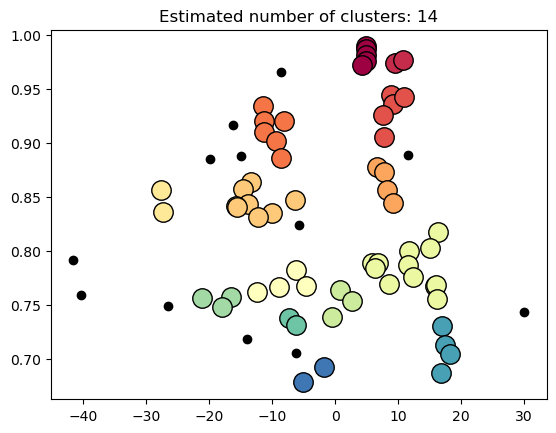

In [29]:
unique_labels = set(labels)
core_samples_mask = np.zeros_like(labels, dtype=bool)
core_samples_mask[model.core_sample_indices_] = True

colors = [plt.cm.Spectral(each) for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = labels == k

    xy = points[class_member_mask & core_samples_mask]

    plt.plot(
        xy[:, 0],
        xy[:, 1],
        "o",
        markerfacecolor=tuple(col),
        markeredgecolor="k",
        markersize=14,
    )

    xy = points[class_member_mask & ~core_samples_mask]
    plt.plot(
        xy[:, 0],
        xy[:, 1],
        "o",
        markerfacecolor=tuple(col),
        markeredgecolor="k",
        markersize=6,
    )

plt.title(f"Estimated number of clusters: {n_clusters_}")
plt.show()

In [140]:
# %matplotlib notebook
# !pip install ipympl
%matplotlib widget

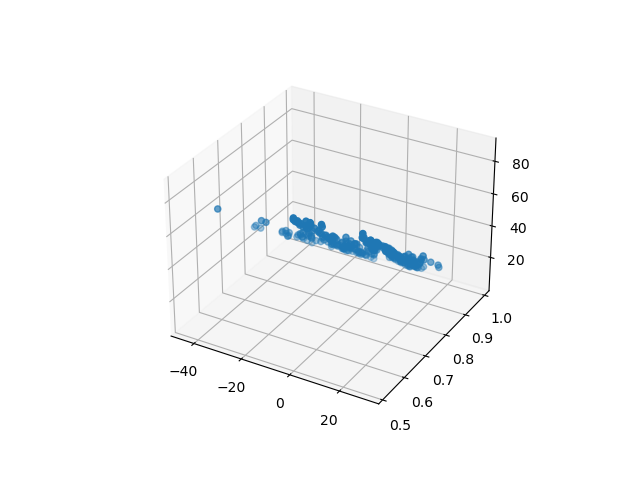

In [141]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(points_xyz[:, 0], points_xyz[:, 1], points_xyz[:, 2])
plt.show()

# Radar -> DBScan -> SORT

In [197]:
pc1.points[0:3, 0]

array([4.93104452, 0.98959228, 4.5255394 ])

In [201]:
print(pc1.points.shape)
print(points1.shape)

(18, 74)
(3, 54)


In [198]:
points1[0:3, 0]

array([1.54608054e+03, 6.55096804e+02, 1.00000000e+00])

In [199]:
int(1.54608054e+03)

1546

In [103]:
points_xyz1 = pc1.points[0:3, :].T
points_xyz1.shape

(74, 3)

In [104]:
points_xyz2 = pc2.points[0:3, :].T
points_xyz2.shape

(61, 3)

In [126]:
points_xyz = np.concatenate((pc1.points[0:3, :].T, pc2.points[0:3, :].T, pc3.points[0:3, :].T, pc4.points[0:3, :].T), axis=0)
points_xyz.shape

(282, 3)

In [127]:
points_xyz[1,:]

array([4.93191173, 0.98735175, 4.92553228])

In [467]:
cluster = DBSCAN(eps=1, min_samples=2)
output = cluster.fit(points_xyz)
output.labels_

array([-1, -1, -1,  0,  0, -1,  1, -1,  2, -1,  3, -1,  4,  5, -1, -1, -1,
       -1, -1, -1,  6,  7, -1, -1,  8, -1,  9, -1, -1, 10, -1, 11, 11, 12,
       -1, -1, -1, -1, -1, -1, 13, 13, -1, 13, -1, -1, -1, 14, -1, -1, -1,
       -1, -1, 15, -1, -1, -1, 16, 16, -1, -1, -1, -1, -1, -1, -1, 17, -1,
       -1, -1, -1, 18, -1, -1, -1,  2,  5, -1, -1, -1, -1,  6, -1,  6,  6,
        7, -1, 19,  9, 10, -1, -1, -1, -1, 20, -1, -1, -1, -1, 21, -1, -1,
       13, -1, 13, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       22, -1, -1, -1, 17, 17, -1, 23, 24, 18, -1, -1, 25, -1, -1, -1, 26,
       26,  1, -1, -1,  2, -1,  4, 27, -1, 28, -1, -1, -1, -1,  8, -1, -1,
       -1, -1, -1, -1, -1, 12, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, 20,
       -1, -1, 21, -1, -1, -1, -1, 29, 14, -1, -1, -1, -1, -1, -1, 22, -1,
       17, -1, -1, -1, -1, -1, 25, -1, -1, -1, -1, 30, 30, -1, -1, -1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,  2,  3, 27, -1, 28,
       -1, -1, -1, -1, 19

In [468]:
labels = output.labels_
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of nose points: %d" % n_noise_)

Estimated number of clusters: 32
Estimated number of nose points: 208


In [469]:
set(output.labels_)

{-1,
 0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31}

In [470]:
# Abscissa is horizontal axis in a two-dimensional coordinate system, often denoted as the x-axis
# Ordinate is vertical axis in a two-dimensional coordinate system, often denoted as the y-axis
# Find abscissa and ordinate for each cluster
dets_list = []
for cluster_id in set(output.labels_):
    if cluster_id != -1:  # -1 represents noise points
        cluster_points = [point for point, label in zip(points_xyz, output.labels_) if label == cluster_id]
        x_min, x_max = min(point[0] for point in cluster_points), max(point[0] for point in cluster_points)
        y_min, y_max = min(point[1] for point in cluster_points), max(point[1] for point in cluster_points)
        z_avg = sum(point[2] for point in cluster_points)/len(cluster_points)
        # for point in cluster_points:
        #     print(point[2])
        # # z_avg = z_avg/len(cluster_points[2])
        # print(len(cluster_points))
        print(f"Cluster {cluster_id}: Abscissa ({x_min}, {x_max}), Ordinate ({y_min}, {y_max}), Z Avg ({z_avg})")
        dets_list.append([x_min, y_min, x_max, y_max])

dets_np = np.array(dets_list)

Cluster 0: Abscissa (4.337550345644862, 4.936247803060148), Ordinate (0.9722740151247741, 0.9761490781408202), Z Avg (7.2261397249076955)
Cluster 1: Abscissa (8.739272481402852, 9.53840329146444), Ordinate (0.9715641914557809, 0.9744904063585108), Z Avg (8.11638863761456)
Cluster 2: Abscissa (8.949678325268156, 10.14924223264135), Ordinate (0.9448492080944639, 0.9503587926539928), Z Avg (12.86489683284527)
Cluster 3: Abscissa (-8.24550523786549, -8.046373185997842), Ordinate (0.9177841384634623, 0.9201960953636062), Z Avg (15.153687166174851)
Cluster 4: Abscissa (10.351843144221343, 10.950973733815518), Ordinate (0.9404478150360446, 0.9432026064984147), Z Avg (13.91303906695885)
Cluster 5: Abscissa (7.354886518529117, 7.556620216214801), Ordinate (0.9257249933953747, 0.9300346419976908), Z Avg (15.919925928672418)
Cluster 6: Abscissa (-15.435946194321243, -14.437249724411174), Ordinate (0.8865325549126958, 0.8911850487609368), Z Avg (19.61820877266701)
Cluster 7: Abscissa (6.5748344317

In [379]:
dets_np.shape

(32, 4)

In [380]:
dets_np

array([[  4.33755035,   0.97227402,   4.9362478 ,   0.97614908],
       [  8.73927248,   0.97156419,   9.53840329,   0.97449041],
       [  8.94967833,   0.94484921,  10.14924223,   0.95035879],
       [ -8.24550524,   0.91778414,  -8.04637319,   0.9201961 ],
       [ 10.35184314,   0.94044782,  10.95097373,   0.94320261],
       [  7.35488652,   0.92572499,   7.55662022,   0.93003464],
       [-15.43594619,   0.88653255, -14.43724972,   0.89118505],
       [  6.57483443,   0.87781669,   7.37396524,   0.8807429 ],
       [-13.42641225,   0.86403548, -13.02771453,   0.86773912],
       [ -6.41862626,   0.84762984,  -6.41775905,   0.84987038],
       [-14.61773666,   0.84060162, -13.81860585,   0.84352783],
       [-15.81860044,   0.84086478, -15.61816756,   0.84181363],
       [  9.18870321,   0.84419661,   9.98870028,   0.84488229],
       [  5.80909139,   0.78466312,   7.20735326,   0.79431093],
       [ 11.61167752,   0.78369013,  11.81297761,   0.78687951],
       [  2.22254306,   0

In [478]:
trackers = mot_tracker.update(dets_np)
len(trackers)

31

In [479]:
for d in trackers:
    print('%d,%.2f,%.2f,%.2f,%.2f,1,-1,-1,-1'%(d[4],d[0],d[1],d[2]-d[0],d[3]-d[1]))

90,-5.11,0.58,0.60,0.00,1,-1,-1,-1
88,-35.23,0.85,0.00,0.00,1,-1,-1,-1
87,-7.84,0.89,0.20,0.00,1,-1,-1,-1
86,6.36,0.92,0.40,0.00,1,-1,-1,-1
85,8.54,0.98,0.20,0.00,1,-1,-1,-1
84,17.46,0.68,0.20,0.00,1,-1,-1,-1
83,11.05,0.70,0.80,0.00,1,-1,-1,-1
82,14.64,0.70,0.80,0.00,1,-1,-1,-1
81,15.23,0.75,0.40,0.00,1,-1,-1,-1
80,5.61,0.80,0.60,0.00,1,-1,-1,-1
79,12.80,0.83,0.80,0.00,1,-1,-1,-1
78,9.77,0.88,1.00,0.00,1,-1,-1,-1
77,17.45,0.70,0.80,0.00,1,-1,-1,-1
76,16.43,0.73,0.61,0.01,1,-1,-1,-1
75,15.82,0.77,0.20,0.00,1,-1,-1,-1
74,2.22,0.75,0.40,0.00,1,-1,-1,-1
73,11.61,0.78,0.20,0.00,1,-1,-1,-1
72,5.81,0.78,1.40,0.01,1,-1,-1,-1
71,9.19,0.84,0.80,0.00,1,-1,-1,-1
70,-15.82,0.84,0.20,0.00,1,-1,-1,-1
69,-14.62,0.84,0.80,0.00,1,-1,-1,-1
68,-6.42,0.85,0.00,0.00,1,-1,-1,-1
67,-13.43,0.86,0.40,0.00,1,-1,-1,-1
66,6.57,0.88,0.80,0.00,1,-1,-1,-1
65,-15.44,0.89,1.00,0.00,1,-1,-1,-1
64,7.35,0.93,0.20,0.00,1,-1,-1,-1
63,10.35,0.94,0.60,0.00,1,-1,-1,-1
62,-8.25,0.92,0.20,0.00,1,-1,-1,-1
61,8.95,0.94,1.20,0.01,1

In [480]:
# Extract indices of core points (non-noise points)
core_points_mask = np.zeros_like(output.labels_, dtype=bool)
core_points_mask[output.core_sample_indices_] = True

# Extract noise points
noise_points_mask = output.labels_ == -1

# Create a new variable without noise points
cleaned_data = points_xyz[core_points_mask]

# Optionally, you can store the noise points in a separate variable
noise_data = points_xyz[noise_points_mask]

# Print the cleaned data and noise points
print("Cleaned Data:")
print(cleaned_data)
print("\nNoise Points:")
print(noise_data)

Cleaned Data:
[[  4.9362478    0.97614908   6.92549596]
 [  4.33755035   0.97227402   7.52678348]
 [  9.53840329   0.97449041   7.91552689]
 [  8.94967833   0.94484921  13.11673086]
 [ -8.04637319   0.9201961   14.95347416]
 [ 10.95097373   0.94320261  13.71239389]
 [  7.55662022   0.92572499  16.31970248]
 [-15.03638127   0.88843026  19.5685335 ]
 [  6.57483443   0.87781669  24.72171385]
 [-13.42641225   0.86403548  24.16498967]
 [ -6.41775905   0.84762984  28.14977464]
 [-13.81860585   0.84352783  27.76579043]
 [-15.81860044   0.84181363  27.77011696]
 [-15.61816756   0.84086478  27.96968147]
 [  9.18870321   0.84419661  31.11597353]
 [  5.80909139   0.78862993  40.52315871]
 [  6.80908868   0.78948703  40.52099544]
 [  6.41082457   0.78466312  41.32184555]
 [ 11.61167752   0.78687951  41.71059086]
 [  2.62167485   0.75339947  46.32997579]
 [ 15.82033811   0.76807399  45.70143298]
 [ 16.02033738   0.76824541  45.70100033]
 [ 17.03507732   0.73101344  52.49871364]
 [ 18.24548141   0.7

In [481]:
cleaned_data.shape

(74, 3)

In [482]:
noise_data.shape

(208, 3)

In [228]:
points_xyz[:5, :]

array([[4.93104452, 0.98959228, 4.5255394 ],
       [4.93191173, 0.98735175, 4.92553228],
       [4.93407977, 0.98175041, 5.925514  ],
       [4.9362478 , 0.97614908, 6.92549596],
       [4.33755035, 0.97227402, 7.52678348]])

In [211]:
cleaned_data[:,0]

array([ -4.89421569,  -3.96694662,   6.65102781, -15.03638127,
         6.80908868,   6.41082457,  17.03507732,   9.94967562,
       -14.43724972, -14.63551456, -15.43594619,  13.59606224,
         6.61039024,  16.63334435,  10.14924223,  12.99432906,
        10.14794141,  12.79563061])

In [306]:
cleaned_data.shape

(114, 3)

In [483]:
cleaned_pc = pc2
cleaned_pc.points = cleaned_data.T

In [309]:
cleaned_pc

In [349]:
type(pc3.points)

numpy.ndarray

In [296]:
points_xyz_pc = pc1
points_xyz_pc.points = points_xyz
points_xyz_points, points_xyz_coloring = calibrate_radar_points(pc3)

In [495]:
cleaned_data_points, cleaned_data_coloring = calibrate_radar_points(cleaned_pc)

depth [ 7.70105104  8.29973219  8.71087779 13.90932229 15.6727242  14.51358669
 17.10615246 20.25745571 25.50357358 24.86065586 28.87548243 28.45961253
 28.45531772 28.6557377  31.908828   41.30104402 41.30319143 42.10229065
 42.51343816 47.0938739  46.52225198 46.52268146 53.32447913 58.12680891
 13.91146969 16.30576384 19.85876506 20.65829567 20.45658724 25.10531241
 25.51259268 28.47550334 28.8578737  35.31810172 39.70198663 40.50409221
 41.90273345 49.92164954 52.52366198 54.12443731 57.51911057 58.51304651
 58.52507198 62.7248572   7.30880261  8.10919075  9.10913943 13.71190963
 14.91227734 18.10438321 19.67337883 24.26154524 31.91054592 34.51685509
 39.70069818 24.61385382 43.11383532 50.52075826 51.72327432 62.32530569
 68.92496926 68.92496926 13.111941   16.07227476 17.70354421 20.27291703
 25.51044528 35.11639329 24.41386332 47.49299594 57.9113609  57.92080949
 76.47690528 76.67560352]
(3, 74)
(3, 74)
-----


In [496]:
cleaned_data_points.shape

(3, 57)

In [497]:
cleaned_data_points

array([[1.58857176e+03, 2.22046454e+02, 1.42651710e+03, 1.17505327e+03,
        1.65599262e+02, 5.62700211e+02, 2.29746609e+02, 1.40648529e+02,
        1.54194009e+02, 1.20568822e+03, 1.01227332e+03, 1.04292414e+03,
        1.02654014e+03, 1.17938009e+03, 9.01785448e+02, 1.26219201e+03,
        1.26763211e+03, 1.23346862e+03, 1.22492514e+03, 1.44106913e+03,
        1.22114196e+03, 1.38340661e+03, 5.59175798e+02, 2.02697077e+02,
        1.32561195e+03, 1.03303380e+03, 1.05995463e+03, 1.03359867e+03,
        1.22657255e+03, 1.23022566e+03, 1.22726315e+03, 1.15000920e+03,
        1.08369430e+03, 1.20481521e+03, 1.17862193e+03, 1.33676294e+03,
        3.68092092e+02, 1.70476510e+02, 1.23741592e+03, 1.31548345e+03,
        1.01390167e+03, 1.18016115e+03, 1.21164860e+03, 1.23177565e+03,
        1.18502578e+03, 1.14946238e+03, 1.14946238e+03, 2.20993703e+02,
        1.31999446e+03, 3.68774043e+02, 1.33381203e+03, 1.29970245e+03,
        8.90378430e+02, 1.06900602e+03, 1.16516770e+03, 7.486815

/tmp/ipykernel_55495/2178938055.py:3: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


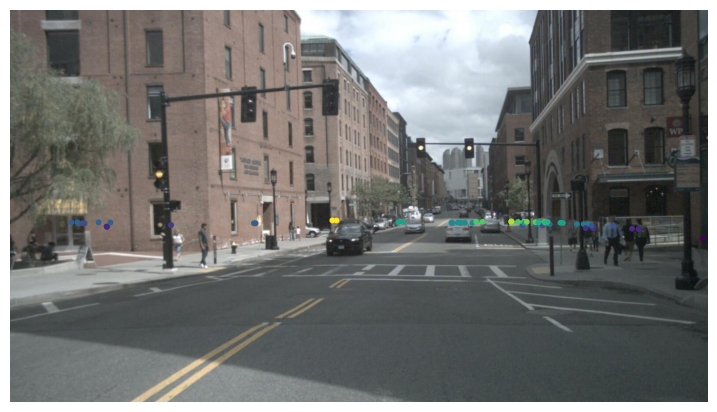

In [498]:
%matplotlib inline
fig, ax = plt.subplots(1, 1, figsize=(9, 16))
fig.canvas.set_window_title("sample token")
ax.imshow(im3)
ax.scatter(cleaned_data_points[0, :], cleaned_data_points[1, :], c=cleaned_data_coloring, s=10)
ax.axis('off')
plt.show()

In [146]:
points_xyz[0:5, :]

array([[4.93104452, 0.98959228, 4.5255394 ],
       [4.93191173, 0.98735175, 4.92553228],
       [4.93407977, 0.98175041, 5.925514  ],
       [4.9362478 , 0.97614908, 6.92549596],
       [4.33755035, 0.97227402, 7.52678348]])

In [144]:
len(labels)

282

In [143]:
points_xyz.shape

(282, 3)

In [137]:
points_xyz[:,1]

array([0.98959228, 0.98735175, 0.98175041, 0.97614908, 0.97227402,
       0.96561278, 0.97449041, 0.97663919, 0.94484921, 0.93408596,
       0.9201961 , 0.93605849, 0.94320261, 0.92572499, 0.92081417,
       0.91073177, 0.90219215, 0.90573161, 0.91652867, 0.88607382,
       0.88843026, 0.87781669, 0.88882379, 0.87324387, 0.86403548,
       0.88543643, 0.84762984, 0.85740562, 0.85678271, 0.84352783,
       0.83558214, 0.84181363, 0.84086478, 0.84419661, 0.83145599,
       0.8246185 , 0.85634571, 0.83635233, 0.78282578, 0.81787999,
       0.78862993, 0.78948703, 0.80049414, 0.78466312, 0.80323686,
       0.76739314, 0.76698269, 0.78687951, 0.76417961, 0.76182803,
       0.76974474, 0.77636252, 0.75710793, 0.75339947, 0.75652606,
       0.74806612, 0.73810686, 0.76807399, 0.76824541, 0.73945408,
       0.7312935 , 0.7496572 , 0.75609389, 0.71900678, 0.79169376,
       0.70552737, 0.73101344, 0.69249461, 0.75911428, 0.71343201,
       0.6783778 , 0.70515556, 0.74327602, 0.68715162, 0.96467

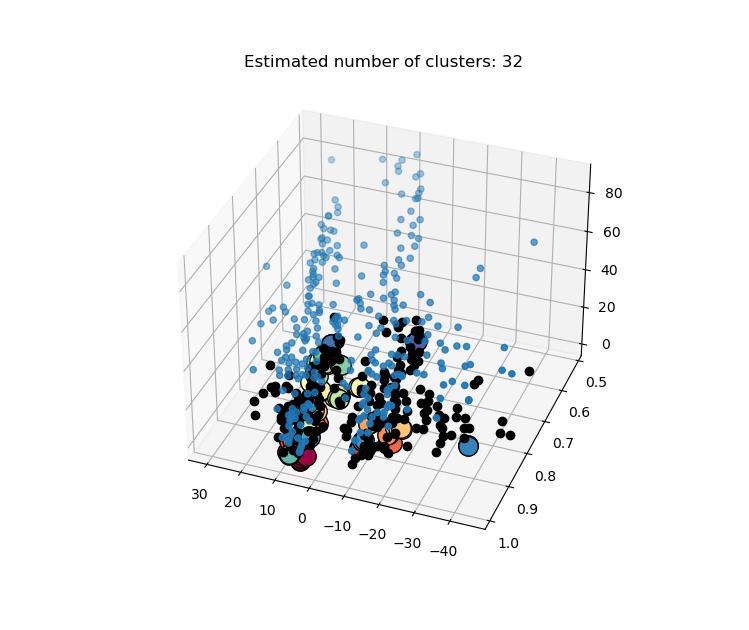

In [142]:
unique_labels = set(labels)
core_samples_mask = np.zeros_like(labels, dtype=bool)
core_samples_mask[output.core_sample_indices_] = True

colors = [plt.cm.Spectral(each) for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = labels == k

    xy = points_xyz[class_member_mask & core_samples_mask]

    plt.plot(
        xy[:, 0],
        xy[:, 1],
        "o",
        markerfacecolor=tuple(col),
        markeredgecolor="k",
        markersize=14,
    )

    xy = points_xyz[class_member_mask & ~core_samples_mask]
    plt.plot(
        xy[:, 0],
        xy[:, 1],
        "o",
        markerfacecolor=tuple(col),
        markeredgecolor="k",
        markersize=6,
    )

plt.title(f"Estimated number of clusters: {n_clusters_}")
plt.show()

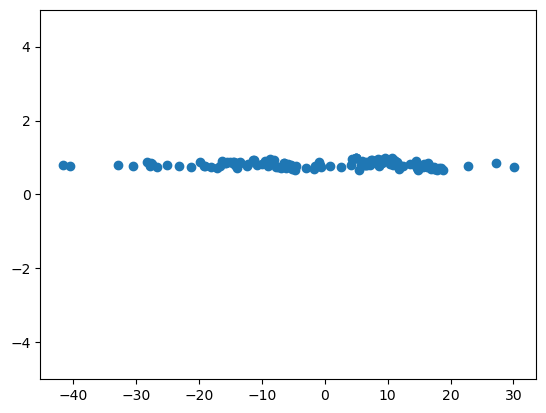

In [96]:
fig = plt.figure()
ax = fig.add_subplot()
ax.set_ylim([-5, 5])
ax.scatter(points_xyz[0, :], points_xyz[1, :])
plt.show()

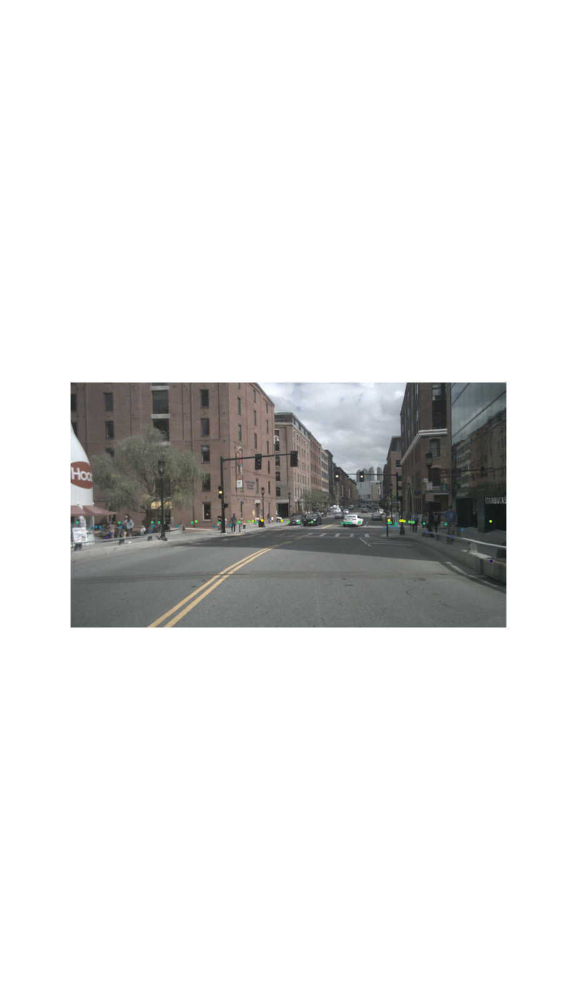

In [32]:
fig, ax = plt.subplots(1, 1, figsize=(9, 16))
# fig.canvas.set_window_title("sample token")
ax.imshow(im)
ax.scatter(points[0, :], points[1, :], c=coloring, s=dot_size)
ax.axis('off')
plt.show()

# Widget Iterative

In [388]:
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

In [499]:
def f(x):
    print("hello")

In [500]:
%matplotlib inline
interact(f, x=10)

interactive(children=(IntSlider(value=10, description='x', max=30, min=-10), Output()), _dom_classes=('widget-…

<function __main__.f(x)>

In [503]:
os.listdir(directory)

['CAM_BACK_RIGHT',
 'RADAR_BACK_RIGHT',
 'CAM_FRONT',
 'RADAR_BACK_LEFT',
 'RADAR_FRONT',
 'LIDAR_TOP',
 'CAM_FRONT_LEFT',
 'CAM_BACK',
 'CAM_BACK_LEFT',
 'CAM_FRONT_RIGHT',
 'RADAR_FRONT_RIGHT',
 'RADAR_FRONT_LEFT']

In [550]:
# Directory containing the files
directory = '/media/asus/backup/Nuscenes/data/sets/nuscenes/samples'

# Filter files based on keywords
image_files = [file for file in os.listdir(os.path.join(directory, 'CAM_FRONT'))]
pcd_files = [file for file in os.listdir(os.path.join(directory, 'RADAR_FRONT'))]





In [510]:
pcd_files

['n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402927664178.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402928114656.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402928719956.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402929175111.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402929699442.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402930155470.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402930680594.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402931210794.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402931660959.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402932190673.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402932641364.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402933171442.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402933626683.pcd',
 'n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402934150966.pcd',
 'n015-2018-07-24-11-22-45+0800__R

In [4]:
# Directory containing the files
directory = '/media/asus/backup/Nuscenes/data/sets/nuscenes/samples'

# Filter files based on keywords
image_files = [file for file in os.listdir(os.path.join(directory, 'CAM_FRONT'))]
pcd_files = [file for file in os.listdir(os.path.join(directory, 'RADAR_FRONT'))]

# Sort files by their timestamp assuming filename format: 'prefix_timestamp.extension'
image_files.sort(key=lambda x: int(x.split('_')[-1].split('.')[0]))
pcd_files.sort(key=lambda x: int(x.split('_')[-1].split('.')[0]))

Estimated number of clusters: 321
Estimated number of nose points: 0
len of trackers 321
depth [ 1.21406730e+01  1.35511768e+01  1.47487377e+01  1.40723061e+01
  1.42874128e+01  1.71481886e+01  1.64717571e+01  1.79653232e+01
  1.79371826e+01  1.78757669e+01  1.95454759e+01  2.09494848e+01
  2.05257653e+01  1.74658406e+01  1.78679134e+01  2.31251713e+01
  2.47291334e+01  2.14541029e+01  2.22582486e+01  2.60782215e+01
  2.76778561e+01  2.13761750e+01  3.06793349e+01  2.27715253e+01
  1.97354118e+01  2.07200306e+01  3.50480234e+01  3.45001121e+01
  3.44900949e+01  3.73717131e+01  3.89323819e+01  4.04164852e+01
  4.05558259e+01  3.69883142e+01  4.13491521e+01  3.89488931e+01
  4.00043933e+01  4.46912852e+01  4.54478121e+01  4.53222617e+01
  4.78515905e+01  4.72979932e+01  4.77144107e+01  4.86903708e+01
  4.98554626e+01  4.33083686e+01  5.06899136e+01  5.37073512e+01
  4.58666480e+01  5.29646222e+01  4.88724561e+01  5.83734064e+01
  4.84487348e+01  4.92377278e+01  6.05902177e+01  6.08572773

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


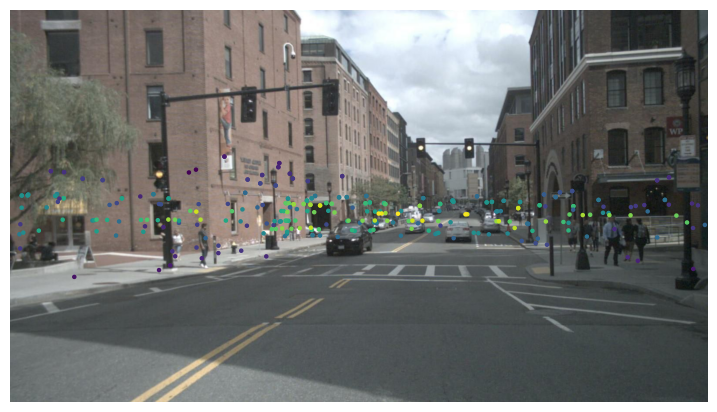

Estimated number of clusters: 337
Estimated number of nose points: 0
len of trackers 337
depth [-1.44982300e+00 -4.72719065e-01 -6.92131890e-01  1.07185490e+01
  1.21150259e+01 -7.31038202e-01  1.06796427e+01  8.55671809e-01
 -1.74380628e+00  1.10568672e+01 -9.69904199e-01 -5.92680206e-01
 -2.78575410e+00 -8.33599767e+00 -8.14252143e+00 -2.82790262e+00
 -2.45392032e+00 -9.40064083e+00 -9.01368930e+00  1.13238566e+01
  1.12979190e+01 -1.65991947e+01  1.14492463e+01 -1.70218112e+01
 -2.03724956e+01 -2.17884252e+01  8.57847980e+00  1.33872427e+01
 -6.01210552e+00  1.54097847e+00 -2.08423656e+00  5.69150256e+00
  8.93844276e-02  2.15466915e+01 -5.23464118e-01  1.79149917e+01
 -1.39013207e+01  1.26220119e+01  8.60984588e+00 -2.98782640e+00
  8.97085893e+00 -5.21980660e+00  1.47729373e+01  1.25571680e+01
  9.33835682e+00 -2.27546730e+01  1.25247461e+01 -4.32375745e+00
 -2.65960581e+01 -1.75113824e+01 -2.60448110e+01  1.80042779e+00
 -2.82378858e+01 -2.92506539e+01  3.36444256e+00  9.55995601

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


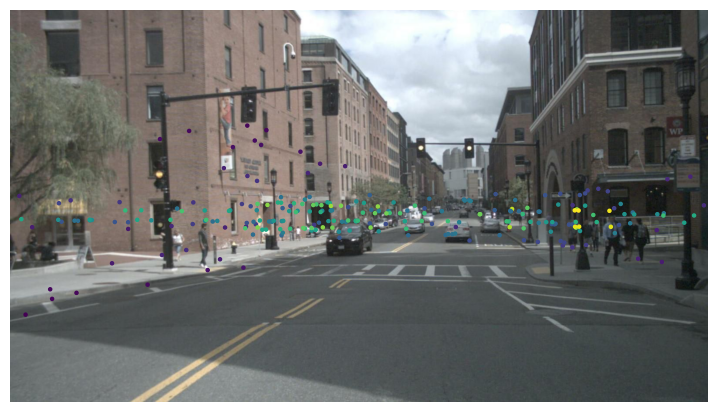

Estimated number of clusters: 359
Estimated number of nose points: 0
len of trackers 359
depth [ 3.23395056e+00  3.24112777e+00  3.26534973e+00  3.05661707e+00
  3.03615364e+00  3.30695632e+00  3.09822366e+00  3.29347589e+00
  3.33791850e+00  3.11565686e+00  3.35198159e+00  3.36941478e+00
  3.40008564e+00  3.44379996e+00  3.44731571e+00  3.44515946e+00
  3.46605984e+00  3.53023761e+00  3.53726912e+00  3.25097541e+00
  3.27871315e+00  3.65330945e+00  3.32730273e+00  3.68441731e+00
  3.69052633e+00  3.73179305e+00  3.45144277e+00  3.35899320e+00
  3.69407074e+00  3.61270259e+00  3.70197623e+00  3.59291892e+00
  3.69210864e+00  3.26043460e+00  3.71623355e+00  3.35664271e+00
  3.92448065e+00  3.54607720e+00  3.62831938e+00  3.82660184e+00
  3.66308862e+00  3.89887930e+00  3.56048016e+00  3.61542153e+00
  3.69092346e+00  4.13384448e+00  3.65009370e+00  3.99273687e+00
  4.24387292e+00  4.20796702e+00  4.28562517e+00  3.96650433e+00
  4.31629601e+00  4.34725818e+00  3.97729436e+00  3.87478304

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


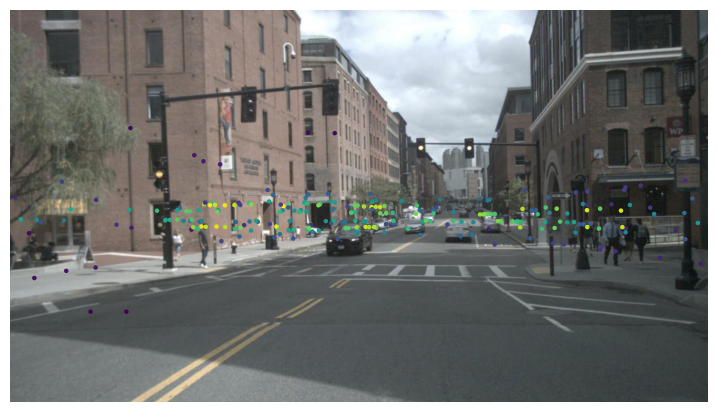

Estimated number of clusters: 377
Estimated number of nose points: 0
len of trackers 2
depth [ 1.28708682e+01  1.42855352e+01  1.54820502e+01  1.48554920e+01
  1.50766806e+01  1.78811556e+01  1.72545974e+01  1.87051586e+01
  1.86656697e+01  1.86601515e+01  2.02772244e+01  2.16827776e+01
  2.12495133e+01  1.81655779e+01  1.85684661e+01  2.38485449e+01
  2.54540224e+01  2.21488995e+01  2.29546759e+01  2.68631713e+01
  2.84625755e+01  2.20395455e+01  3.14644953e+01  2.34329482e+01
  2.03824266e+01  2.13607907e+01  3.58203290e+01  3.52934548e+01
  3.51987327e+01  3.81131198e+01  3.96578451e+01  4.11757919e+01
  4.12906612e+01  3.78171023e+01  4.20812533e+01  3.97616801e+01
  4.06781797e+01  4.54805403e+01  4.62194931e+01  4.60433116e+01
  4.86246718e+01  4.80091527e+01  4.85128363e+01  4.94790500e+01
  5.06300018e+01  4.39432557e+01  5.14783048e+01  5.44219538e+01
  4.64845746e+01  5.36216965e+01  4.94925696e+01  5.91144081e+01
  4.90593034e+01  4.98438165e+01  6.13378863e+01  6.16319785e+

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: divide by zero encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:86: RuntimeWarning: invalid value encountered in multiply
  w = np.sqrt(x[2] * x[3])
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


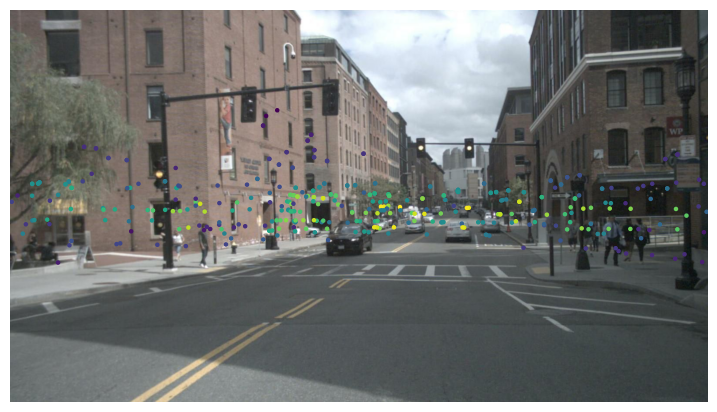

Estimated number of clusters: 404
Estimated number of nose points: 0
len of trackers 4
depth [-7.40887932e-01  2.30174722e-01  5.73013160e-03 ...  7.16516415e+01
  8.27301860e+01  8.14999250e+01]
(3, 1050)
(3, 1050)
-----


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


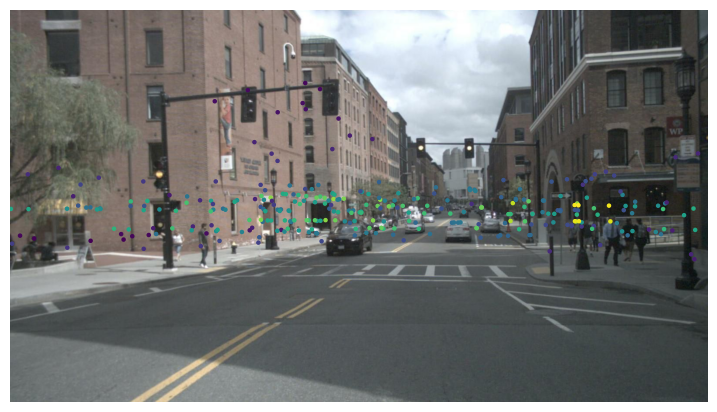

Estimated number of clusters: 425
Estimated number of nose points: 0
len of trackers 7
depth [ 4.04267455  4.05175582  4.08207687 ... 81.3851568  85.29682327
 86.89722554]
(3, 1118)
(3, 1118)
-----


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


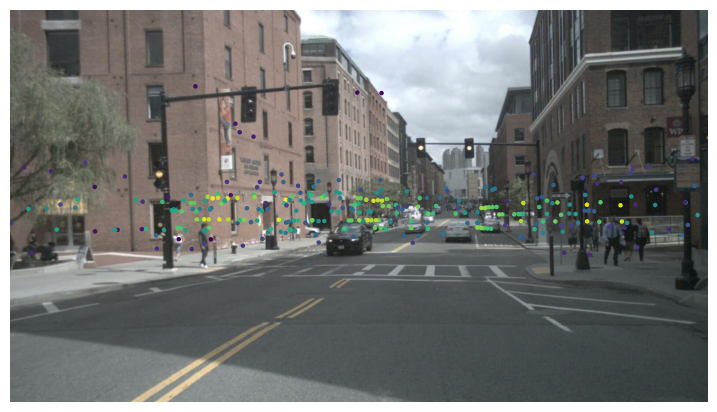

Estimated number of clusters: 456
Estimated number of nose points: 0
len of trackers 5
depth [13.60063501 15.01943106 16.21485263 ... 80.38863607 82.69254516
 86.31670731]
(3, 1188)
(3, 1188)
-----


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


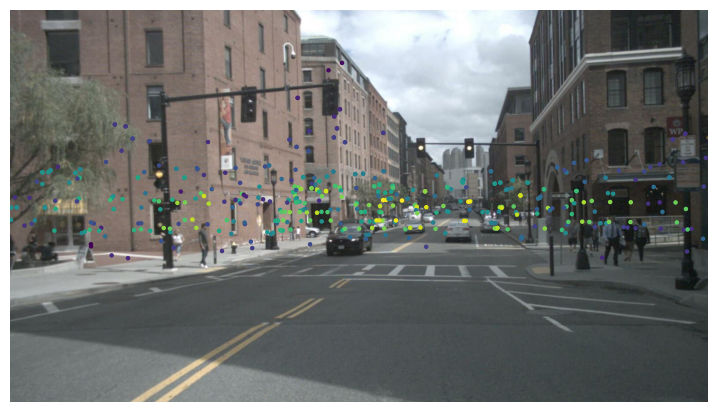

Estimated number of clusters: 478
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 9
depth [-3.16139565e-02  9.33397862e-01  7.03952379e-01 ...  6.42239763e+01
  7.41831265e+01  6.44287288e+01]
(3, 1265)
(3, 1265)
-----


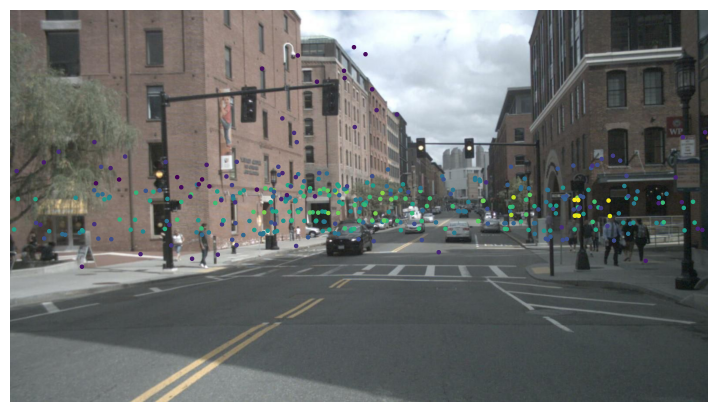

Estimated number of clusters: 498
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:87: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 9
depth [ 4.8514865   4.86251552  4.89895245 ... 79.09390958 78.59473027
 82.49298448]
(3, 1334)
(3, 1334)
-----


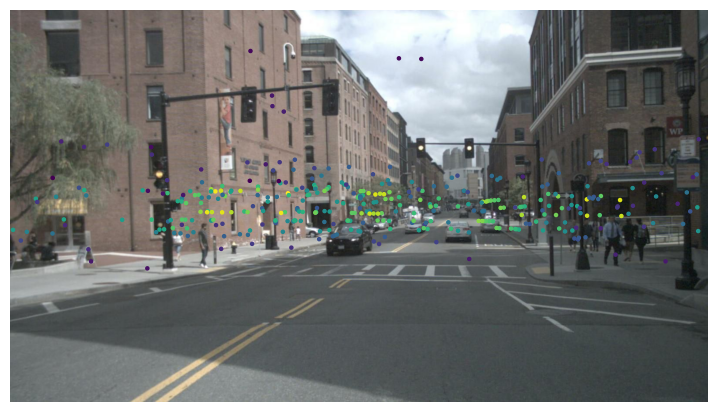

Estimated number of clusters: 519
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:87: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 11
depth [14.32997461 15.75286539 16.94714572 ... 75.4887842  75.39781199
 82.30726108]
(3, 1396)
(3, 1396)
-----


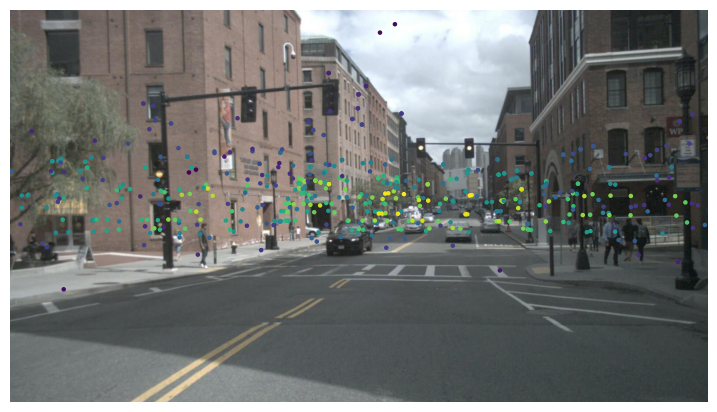

Estimated number of clusters: 528
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: divide by zero encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:86: RuntimeWarning: invalid value encountered in multiply
  w = np.sqrt(x[2] * x[3])
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 9
depth [ 0.67800113  1.6369529   1.40253767 ... 75.7125735  56.64704175
 72.19224826]
(3, 1465)
(3, 1465)
-----


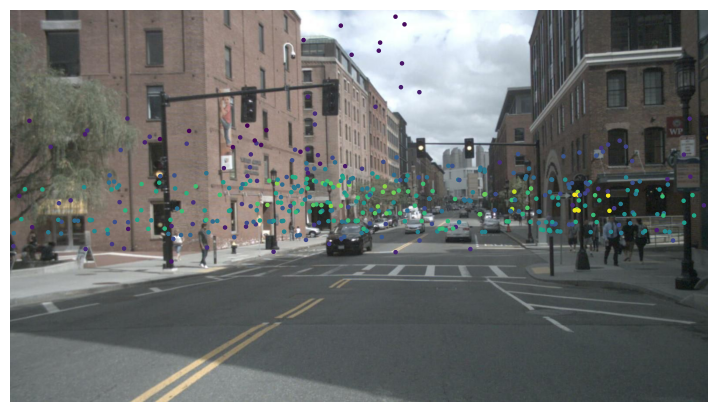

Estimated number of clusters: 549
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 10
depth [ 5.66038311  5.67340346  5.7159727  ... 69.03222047 84.73404385
 72.23562092]
(3, 1542)
(3, 1542)
-----


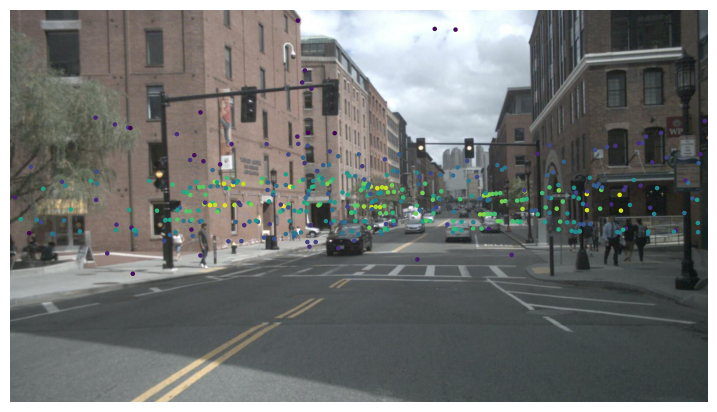

Estimated number of clusters: 564
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 8
depth [15.05888807 16.48583901 17.67893047 ... 77.66061897 84.30462908
 86.10459967]
(3, 1615)
(3, 1615)
-----


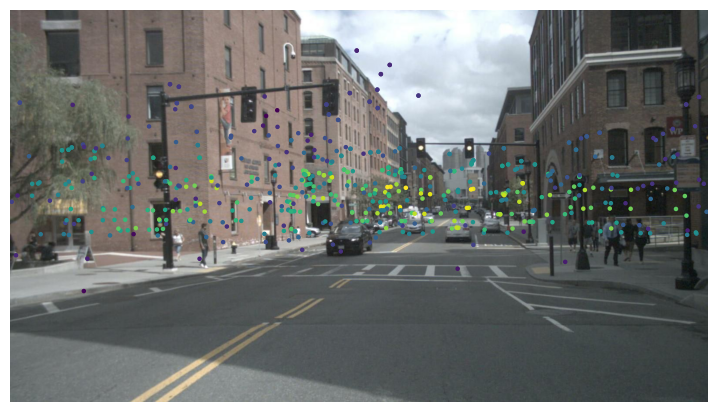

Estimated number of clusters: 595
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 9
depth [  1.38795953   2.34084237   2.10148882 ... 106.7825369   95.45369623
  15.1352989 ]
(3, 1691)
(3, 1691)
-----


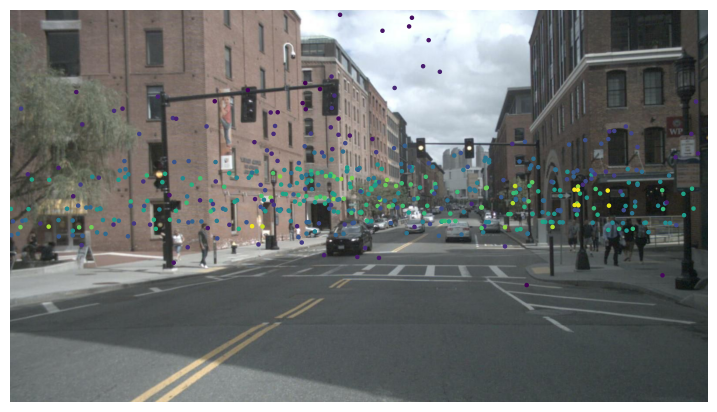

Estimated number of clusters: 617
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 9
depth [ 6.46936108  6.48441625  6.53313388 ... 77.59269233 88.22451597
 87.21890951]
(3, 1759)
(3, 1759)
-----


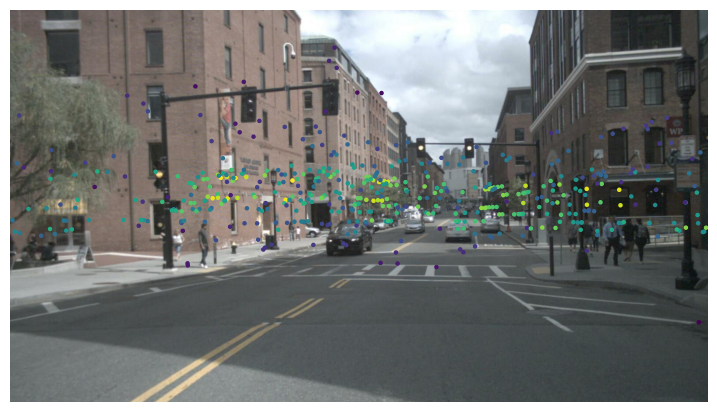

Estimated number of clusters: 655
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 8
depth [ 15.78737652  17.21835284  18.41020782 ... 109.59373844 105.42723888
  93.77119702]
(3, 1827)
(3, 1827)
-----


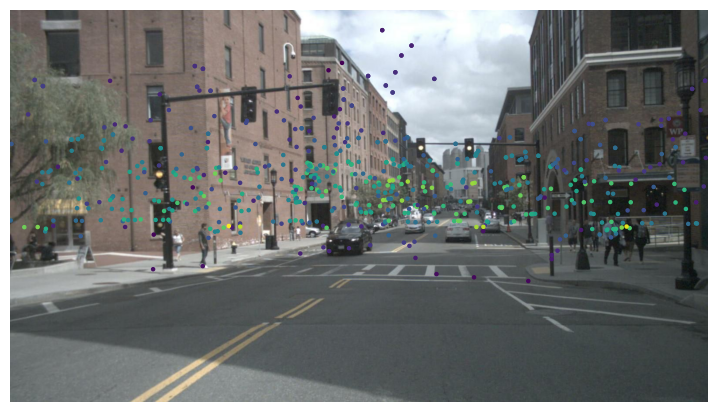

Estimated number of clusters: 675
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 9
depth [  2.09826341   3.04506877   2.8008086  ... 109.57037514  15.53702287
  16.73397246]
(3, 1888)
(3, 1888)
-----


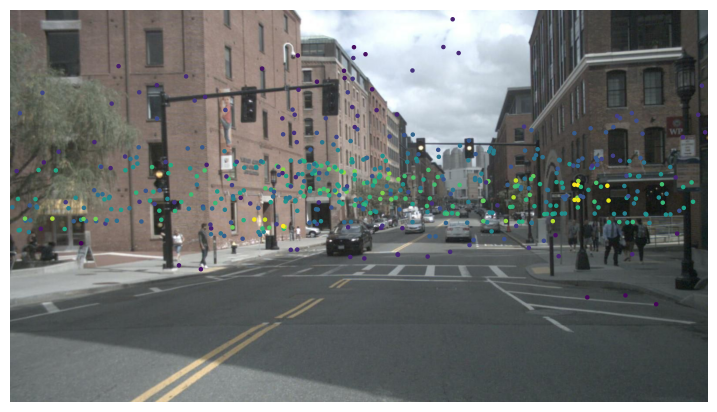

Estimated number of clusters: 693
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)


len of trackers 7
depth [ 7.2784171   7.29555045  7.35043224 ... 91.39536012 76.66096238
 92.797067  ]
(3, 1952)
(3, 1952)
-----


/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


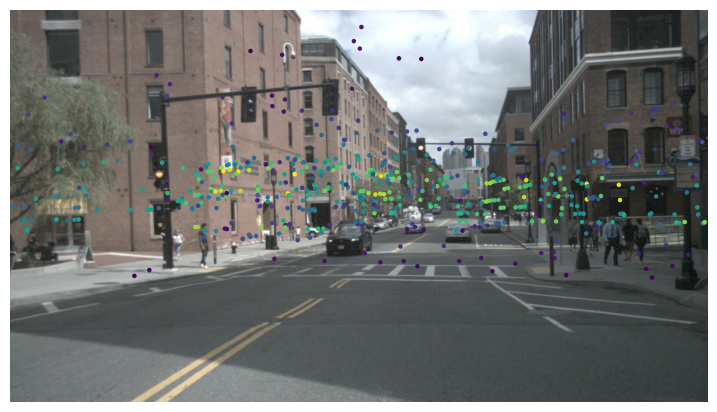

Estimated number of clusters: 713
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 7
depth [16.5154411  17.9504078  19.14097879 ... 11.13320778 27.33681022
 46.73170071]
(3, 2015)
(3, 2015)
-----


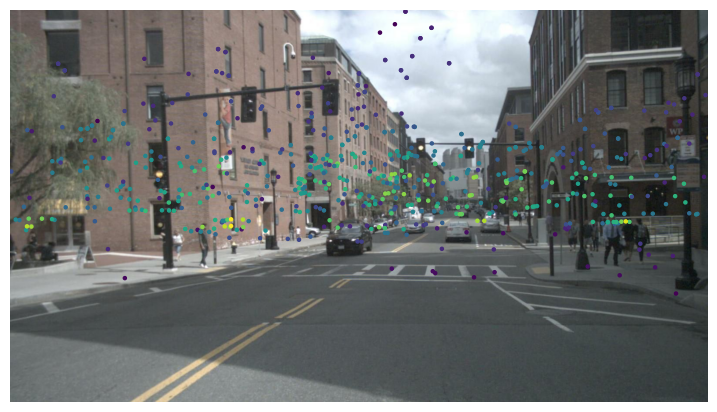

Estimated number of clusters: 735
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 5
depth [ 2.80891492  3.7496346   3.50049978 ... 73.98973021 82.47772668
 84.07553302]
(3, 2078)
(3, 2078)
-----


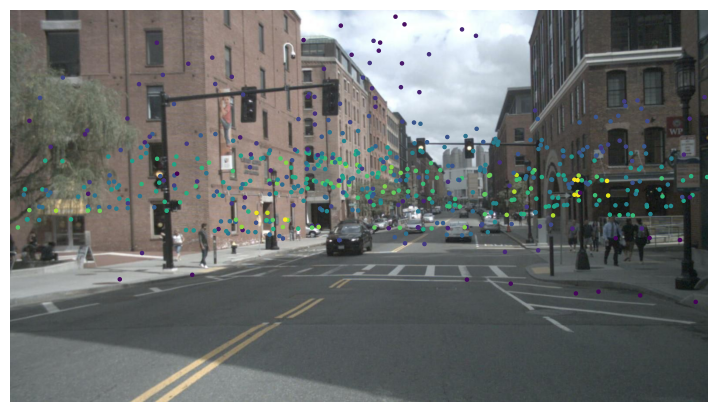

Estimated number of clusters: 752
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 3
depth [  8.08754786   8.10680264   8.16786399 ...  96.38834746 100.16924521
  85.65993473]
(3, 2136)
(3, 2136)
-----


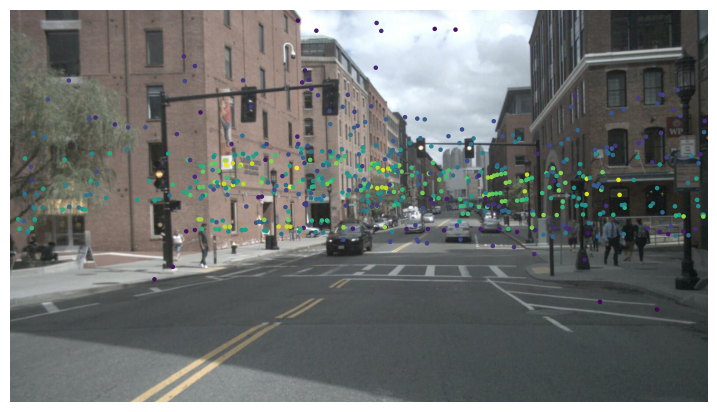

Estimated number of clusters: 782
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: divide by zero encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:86: RuntimeWarning: invalid value encountered in multiply
  w = np.sqrt(x[2] * x[3])
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 3
depth [17.24308298 18.68200483 19.87124438 ... 88.51623955 86.98418896
 76.44105933]
(3, 2199)
(3, 2199)
-----


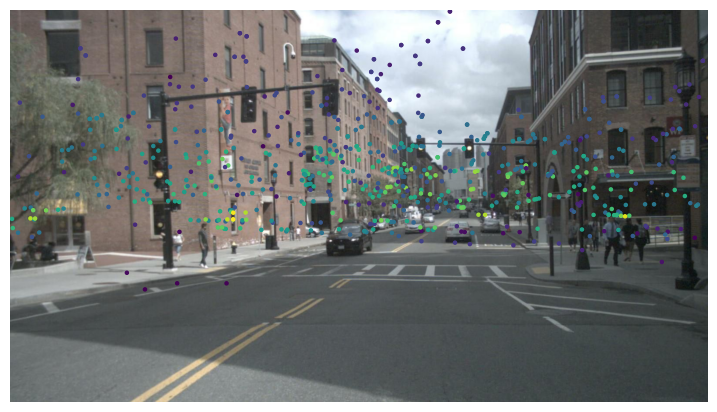

Estimated number of clusters: 805
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 3
depth [ 3.5199162   4.45454233  4.2005651  ... 83.53190528 84.56866281
 88.53787224]
(3, 2260)
(3, 2260)
-----


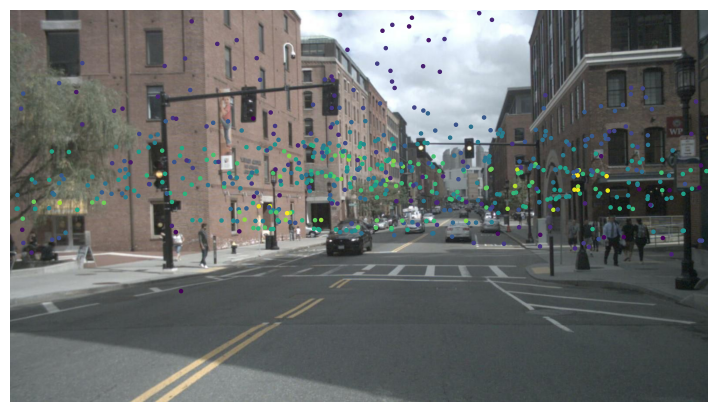

Estimated number of clusters: 830
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: divide by zero encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:86: RuntimeWarning: invalid value encountered in multiply
  w = np.sqrt(x[2] * x[3])
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 4
depth [ 8.89675005  8.91816939  8.98542538 ... 76.95538153 73.26242742
 82.91893038]
(3, 2316)
(3, 2316)
-----


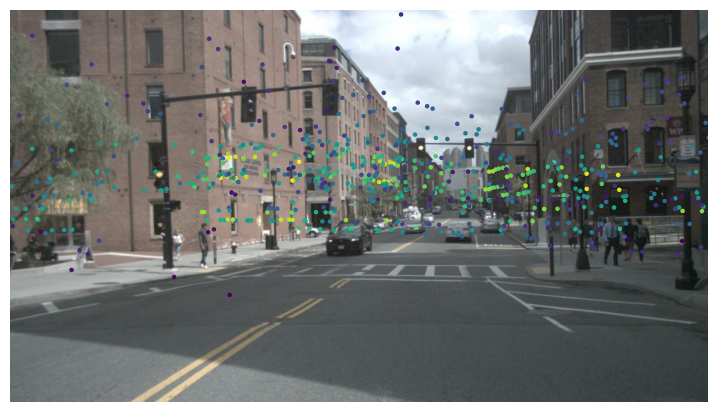

Estimated number of clusters: 857
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: divide by zero encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:86: RuntimeWarning: invalid value encountered in multiply
  w = np.sqrt(x[2] * x[3])
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 3
depth [ 17.97030336  19.41314491  20.60100566 ...  99.69526709 101.89262844
  83.49285152]
(3, 2377)
(3, 2377)
-----


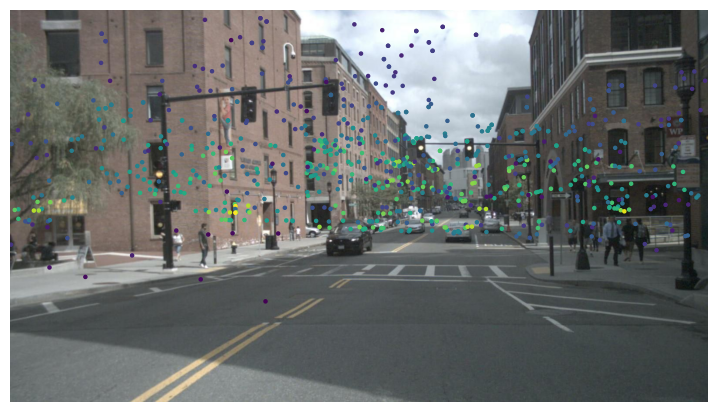

Estimated number of clusters: 881
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 3
depth [  4.23126937   5.15979441   4.90100727 ...  97.47670571  78.69077941
 110.27084576]
(3, 2442)
(3, 2442)
-----


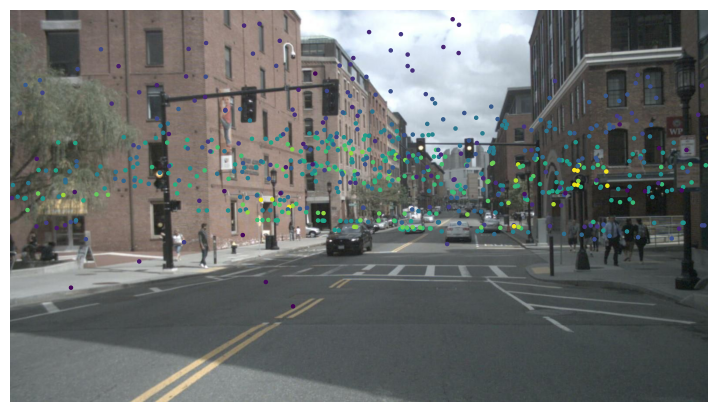

Estimated number of clusters: 912
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: divide by zero encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:86: RuntimeWarning: invalid value encountered in multiply
  w = np.sqrt(x[2] * x[3])
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 4
depth [  9.70602035   9.72964725   9.8031126  ...  80.08209498 104.64585437
 119.83692406]
(3, 2501)
(3, 2501)
-----


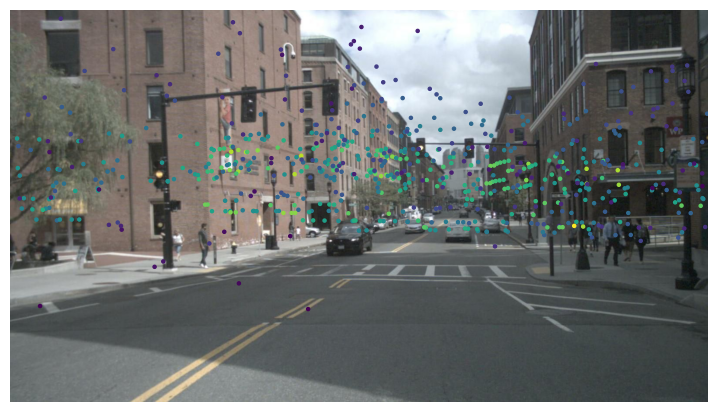

Estimated number of clusters: 937
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: divide by zero encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:87: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:86: RuntimeWarning: invalid value encountered in multiply
  w = np.sqrt(x[2] * x[3])
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was

len of trackers 5
depth [18.69710345 20.14382905 21.33026369 ... 88.85652001 90.2534677
 99.7615704 ]
(3, 2569)
(3, 2569)
-----


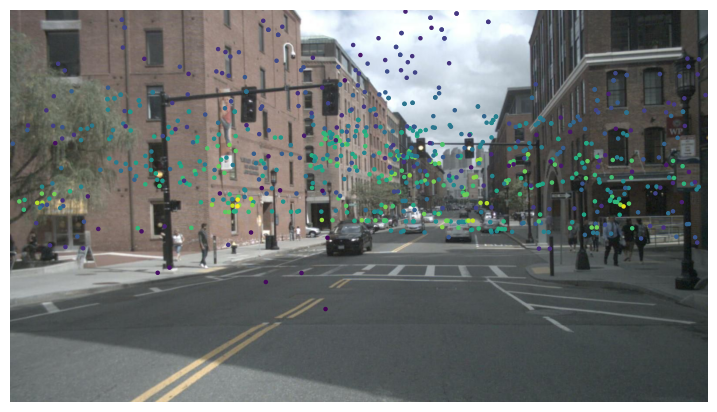

Estimated number of clusters: 956
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:87: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 7
depth [ 4.94297652  5.86539328  5.60182901 ... 79.05528849 95.89533259
 97.07195221]
(3, 2634)
(3, 2634)
-----


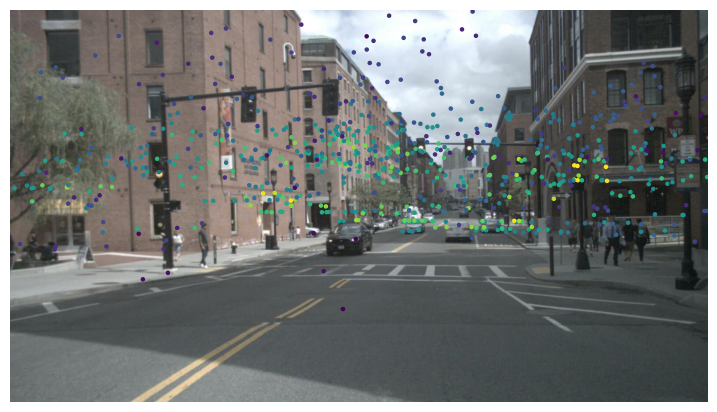

Estimated number of clusters: 972
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 6
depth [10.51535542 10.54123279 10.62092189 ... 87.70889582 87.01707064
 94.50877621]
(3, 2692)
(3, 2692)
-----


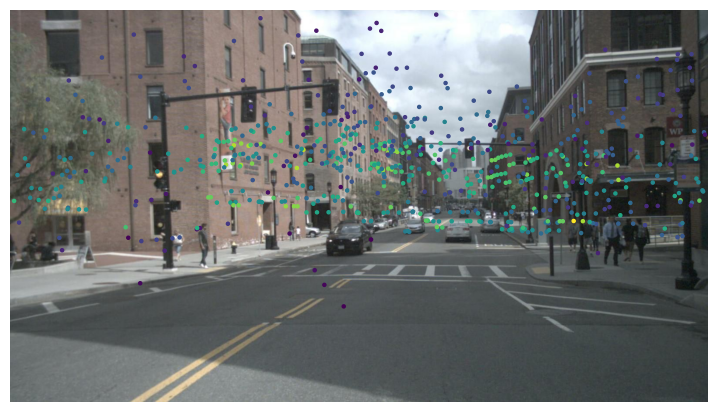

Estimated number of clusters: 985
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:87: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 6
depth [ 19.42348451  20.87405826  22.05901958 ... 104.89343963 116.09064626
 116.65731957]
(3, 2759)
(3, 2759)
-----


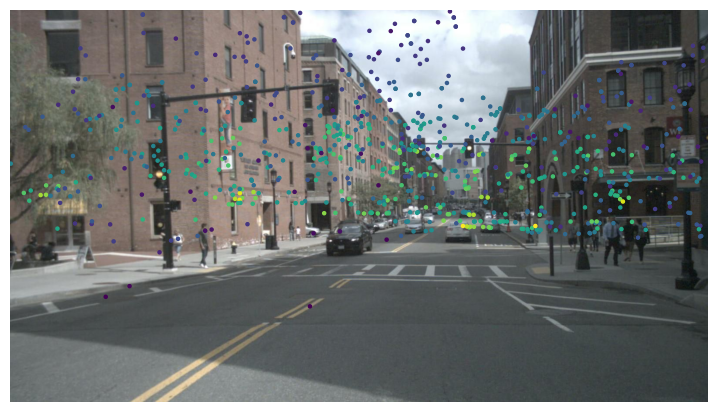

Estimated number of clusters: 1013
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:87: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)


len of trackers 7
depth [  5.65503973   6.57134134   6.30303298 ... 111.6448628  117.87979287
 116.25516199]
(3, 2829)
(3, 2829)
-----


/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


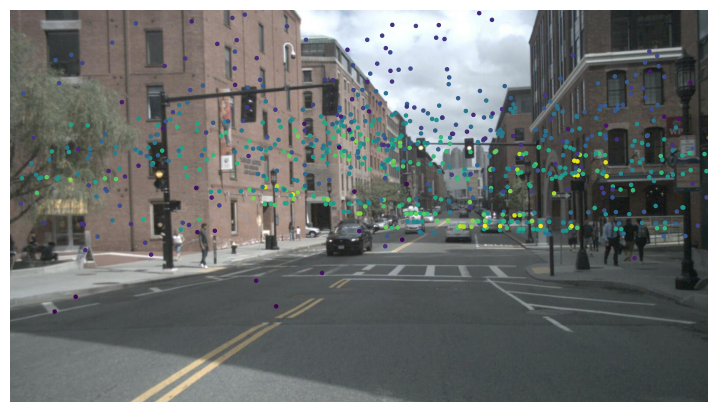

Estimated number of clusters: 1033
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 5
depth [ 11.32475196  11.35292255  11.43884943 ... 107.29166725 110.07128507
 115.46729531]
(3, 2895)
(3, 2895)
-----


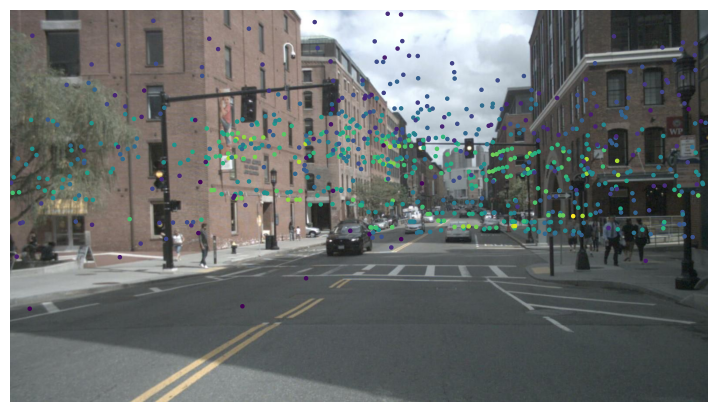

Estimated number of clusters: 1054
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 4
depth [20.14944778 21.60383361 22.78727446 ... 97.35080345 34.33365347
 49.52429433]
(3, 2964)
(3, 2964)
-----


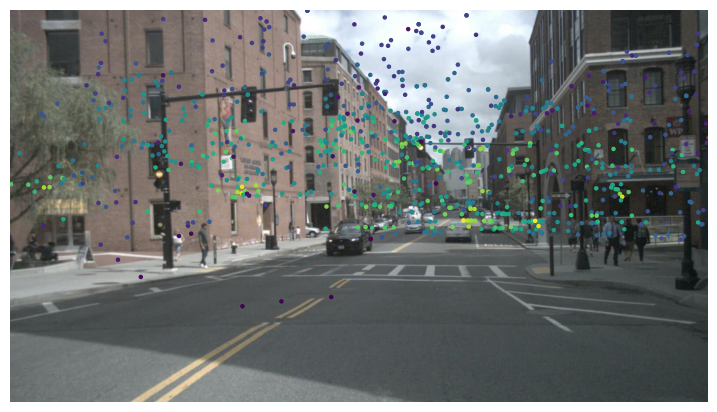

Estimated number of clusters: 1073
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 5
depth [  6.36746105   7.27764101   7.00462185 ... 103.48871179 115.09499084
 111.45092661]
(3, 3026)
(3, 3026)
-----


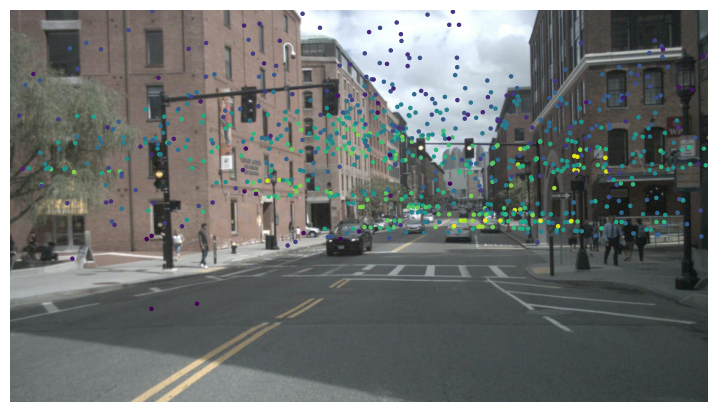

Estimated number of clusters: 1089
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: divide by zero encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:86: RuntimeWarning: invalid value encountered in multiply
  w = np.sqrt(x[2] * x[3])
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 7
depth [12.13420662 12.16471307 12.25689143 ... 85.92925996 87.51625759
 87.90110139]
(3, 3095)
(3, 3095)
-----


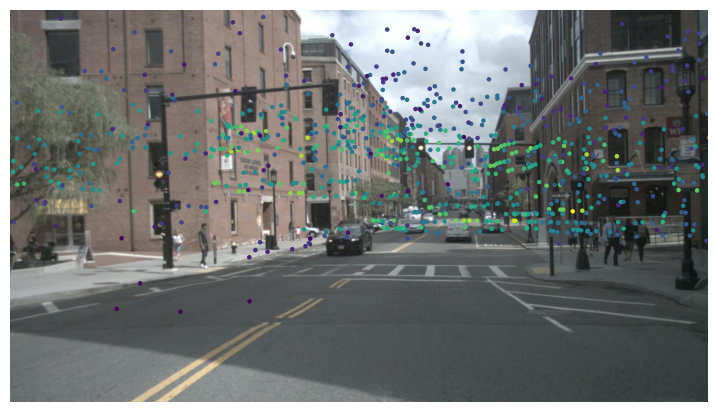

Estimated number of clusters: 1110
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 6
depth [20.87499457 22.33315617 23.5150295  ... 71.62568224 89.11882313
 73.62478085]
(3, 3165)
(3, 3165)
-----


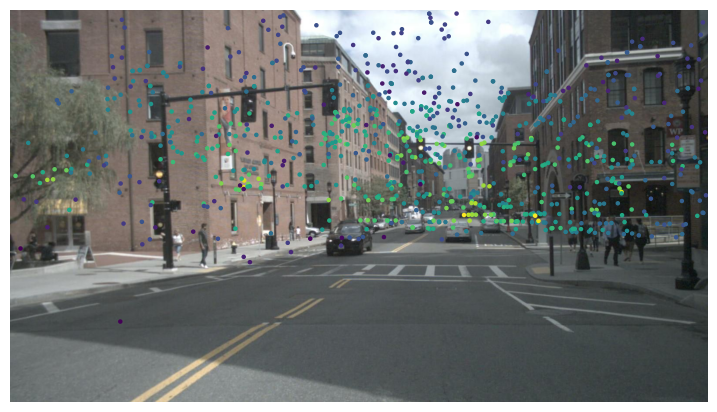

Estimated number of clusters: 1131
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 8
depth [ 7.08024253  7.98429465  7.70659825 ... 75.26239135 82.10510447
 77.86234292]
(3, 3241)
(3, 3241)
-----


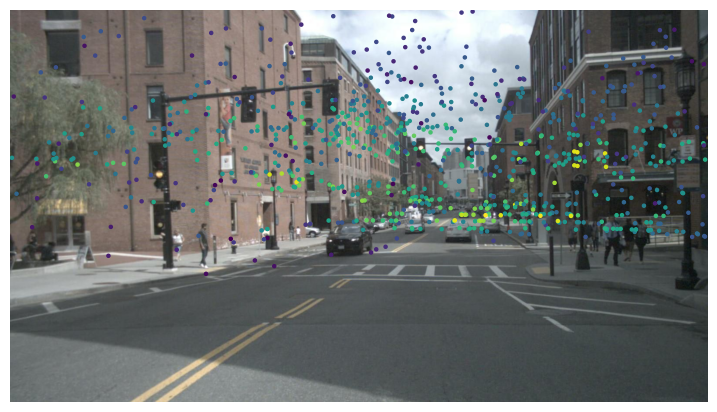

Estimated number of clusters: 1149
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/3011505437.py:64: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


len of trackers 10
depth [12.94371607 12.97660089 13.07504407 ... 54.804786   80.0943242
 73.4520447 ]
(3, 3302)
(3, 3302)
-----


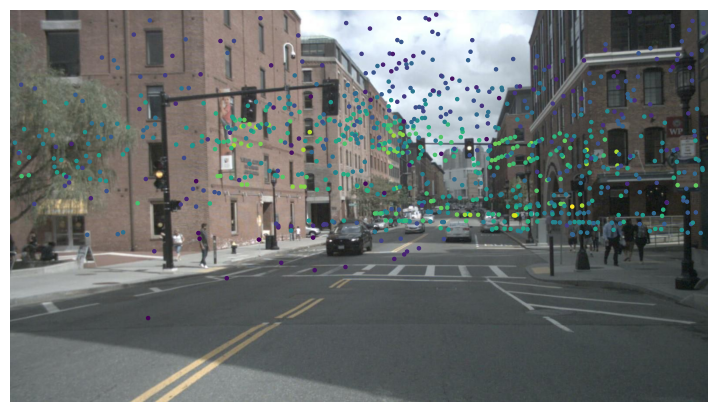

Estimated number of clusters: 1175
Estimated number of nose points: 0


KeyboardInterrupt: 

In [139]:
def process_radar(current_pc : RadarPointCloud, previous_pc: RadarPointCloud, im: Image):
    # global previous_pc
    print("earlier prev", previous_pc.points.shape)
    print("earlier cur", current_pc.points.shape)
    # step 1: check if previous frame radar data is available
    # step 2: combine the points from the previous and current frame of radar data
    points_xyz = np.concatenate((previous_pc.points[0:3, :].T, current_pc.points[0:3, :].T), axis=0)
    # step 3: db scan to find the clusters
    output = dbscan.fit(points_xyz)
    labels = output.labels_
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)

    print("Estimated number of clusters: %d" % n_clusters_)
    print("Estimated number of nose points: %d" % n_noise_)

    # step 4: find the cluster detections
    # Abscissa is horizontal axis in a two-dimensional coordinate system, often denoted as the x-axis
    # Ordinate is vertical axis in a two-dimensional coordinate system, often denoted as the y-axis
    # Find abscissa and ordinate for each cluster
    dets_list = []
    for cluster_id in set(output.labels_):
        if cluster_id != -1:  # -1 represents noise points
            cluster_points = [point for point, label in zip(points_xyz, output.labels_) if label == cluster_id]
            x_min, x_max = min(point[0] for point in cluster_points) * 2, max(point[0] for point in cluster_points) * 2
            # y_min, y_max = min(point[1] for point in cluster_points) * 2, max(point[1] for point in cluster_points) * 2
            z_avg = sum(point[2] for point in cluster_points)/len(cluster_points)
            print('z_avg : ', z_avg)
            y_min, y_max = z_avg - 0.1, z_avg + 0.1
            # for point in cluster_points:
            #     print(point[2])
            # # z_avg = z_avg/len(cluster_points[2])
            # print(len(cluster_points))
            # print(f"Cluster {cluster_id}: Abscissa ({x_min}, {x_max}), Ordinate ({y_min}, {y_max}), Z Avg ({z_avg})")
            dets_list.append([x_min, y_min, x_max, y_max])

    # if (len(dets_list)) == 0:

    dets_np = np.array(dets_list)
    print("dets np shape", dets_np.shape)
    trackers = mot_tracker.update(dets_np)
    print("len of trackers", len(trackers))

    
    # for d in trackers:
    #     print('%d,%.2f,%.2f,%.2f,%.2f,1,-1,-1,-1'%(d[4],d[0],d[1],d[2]-d[0],d[3]-d[1]))
    
    # step 5: getting the core points from the clusters
    # Extract indices of core points (non-noise points)
    core_points_mask = np.zeros_like(output.labels_, dtype=bool)
    core_points_mask[output.core_sample_indices_] = True

    # Extract noise points
    noise_points_mask = output.labels_ == -1

    # Create a new variable without noise points
    cleaned_data = points_xyz[core_points_mask]

    # Optionally, you can store the noise points in a separate variable
    noise_data = points_xyz[noise_points_mask]

    # Print the cleaned data and noise points
    # print("Cleaned Data:")
    # print(cleaned_data)
    # print("\nNoise Points:")
    # print(noise_data)
    cleaned_data_pc = current_pc
    cleaned_data_pc.points = cleaned_data.T
    cleaned_data_points, cleaned_data_coloring = calibrate_radar_points(cleaned_data_pc, im)
    # %matplotlib inline
    fig, ax = plt.subplots(1, 1, figsize=(9, 16))
    fig.canvas.set_window_title("sample token")
    ax.imshow(im)
    ax.scatter(cleaned_data_points[0, :], cleaned_data_points[1, :], c=cleaned_data_coloring, s=5)
    colours = np.random.rand(32, 3) #used only for display
    trackers_data = []
    for d in trackers:
        print("traker data ", d[0], d[1], d[2], d[3], d[4])
        d = d.astype(np.int32)
        # print('tracker datad)
        # tracker_pc = deepcopy(previous_pc)
        # tracker_pc

        trackers_data.append([sum([d[0], d[2]])/2, 0, sum([d[1], d[3]])/2])
    if len(trackers_data) != 0:
        trackers_np = np.array(trackers_data)
        print('tracker shape', trackers_np.shape)
        print('tracker np', trackers_np)
        trackers_points = view_points(trackers_np.T, np.array(cs_record['camera_intrinsic']), normalize=True)
        # ax.add_patch(patches.Rectangle((d[0],d[1]),d[2]-d[0],d[3]-d[1],fill=False,lw=3,ec=colours[d[4]%32,:]))
    
        min_dist : float = 1.0
        dot_size : int = 5
        mask = np.ones(trackers_points.T.shape[0], dtype=bool)
        # mask = np.logical_and(mask, depths > min_dist)
        print('mask shape', mask.shape, ' tracker_points shape', trackers_points.T.shape)
        values = trackers_points[0, :] > 1
        print('values shape', values.shape)
        mask = np.logical_and(mask, values)
        mask = np.logical_and(mask, trackers_points[0, :] < im.size[0] - 1)
        mask = np.logical_and(mask, trackers_points[1, :] > 1)
        mask = np.logical_and(mask, trackers_points[1, :] < im.size[1] - 1)
        trackers_points = trackers_points[:, mask]
        print('tracker np', trackers_points)
        plt.scatter(trackers_points.T[0, :], trackers_points.T[1, :], s=100, color='blue', alpha=0.5)

    ax.axis('off')
    plt.show()
    previous_pc.points = current_pc.points
    points_xyz = np.array([])
    print("previous_pc ", previous_pc.points.shape)
    print("point xyz", points_xyz.shape)
    # input("waiting for next frame")


/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/CAM_FRONT/n015-2018-07-24-11-22-45+0800__CAM_FRONT__1532402927612460.jpg
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/RADAR_FRONT/n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402927664178.pcd
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/CAM_FRONT/n015-2018-07-24-11-22-45+0800__CAM_FRONT__1532402928112460.jpg
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/RADAR_FRONT/n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402928114656.pcd
earlier prev (18, 74)
earlier cur (18, 66)
Estimated number of clusters: 57
Estimated number of nose points: 0
len of trackers 57


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/726013534.py:66: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


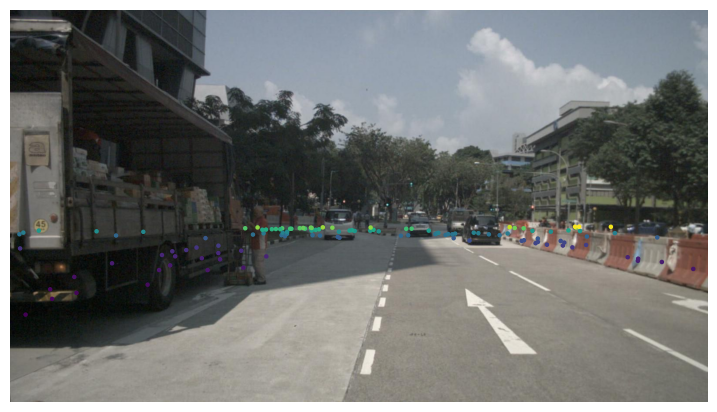

previous_pc  (3, 140)
point xyz (0,)
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/CAM_FRONT/n015-2018-07-24-11-22-45+0800__CAM_FRONT__1532402928662460.jpg
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/RADAR_FRONT/n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402928719956.pcd
earlier prev (3, 140)
earlier cur (18, 67)
Estimated number of clusters: 104
Estimated number of nose points: 0
len of trackers 104


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/726013534.py:66: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


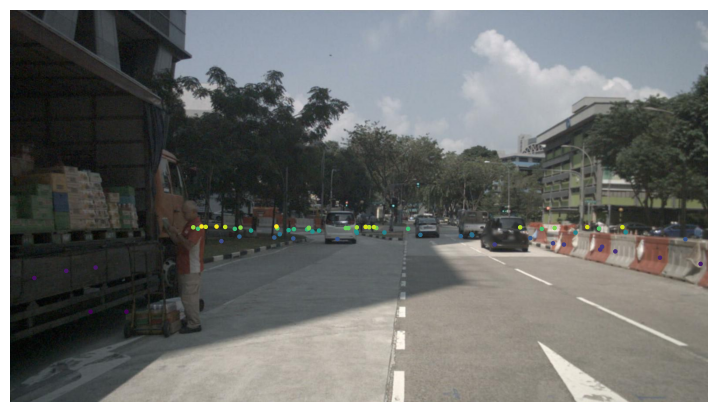

previous_pc  (3, 207)
point xyz (0,)
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/CAM_FRONT/n015-2018-07-24-11-22-45+0800__CAM_FRONT__1532402929162460.jpg
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/RADAR_FRONT/n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402929175111.pcd
earlier prev (3, 207)
earlier cur (18, 68)
Estimated number of clusters: 143
Estimated number of nose points: 0
len of trackers 143


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: divide by zero encountered in scalar divide
  r = w / float(h)
/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:86: RuntimeWarning: invalid value encountered in multiply
  w = np.sqrt(x[2] * x[3])
/tmp/ipykernel_55495/726013534.py:66: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


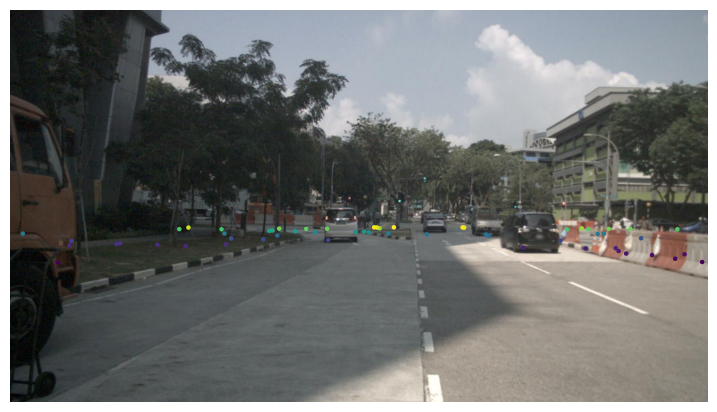

previous_pc  (3, 275)
point xyz (0,)
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/CAM_FRONT/n015-2018-07-24-11-22-45+0800__CAM_FRONT__1532402929662460.jpg
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/RADAR_FRONT/n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402929699442.pcd
earlier prev (3, 275)
earlier cur (18, 71)
Estimated number of clusters: 171
Estimated number of nose points: 0
len of trackers 1


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/726013534.py:66: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


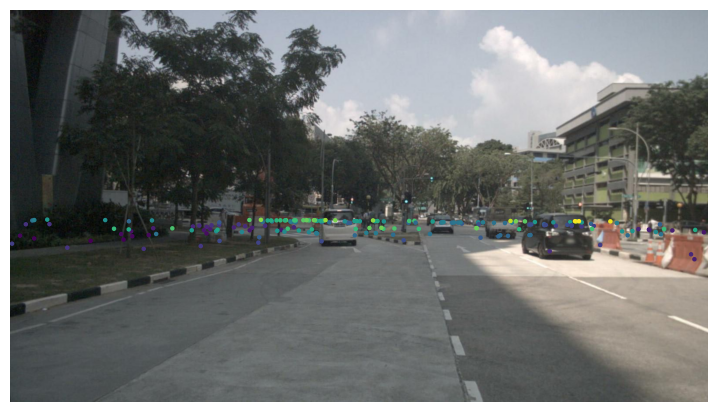

previous_pc  (3, 346)
point xyz (0,)
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/CAM_FRONT/n015-2018-07-24-11-22-45+0800__CAM_FRONT__1532402930112460.jpg
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/RADAR_FRONT/n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402930155470.pcd
earlier prev (3, 346)
earlier cur (18, 68)
Estimated number of clusters: 207
Estimated number of nose points: 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)


len of trackers 0


/tmp/ipykernel_55495/726013534.py:66: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


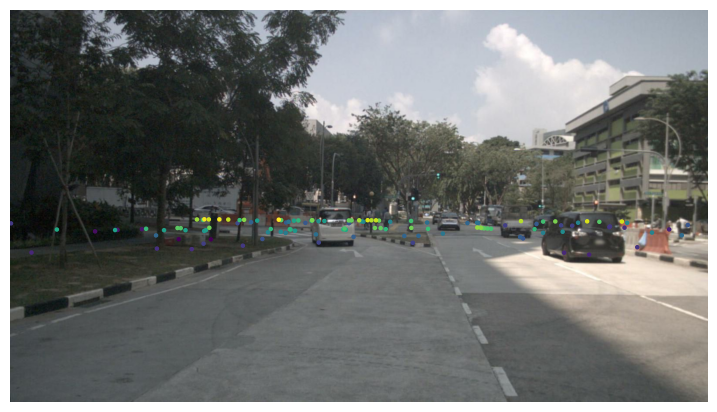

previous_pc  (3, 414)
point xyz (0,)
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/CAM_FRONT/n015-2018-07-24-11-22-45+0800__CAM_FRONT__1532402930612460.jpg
/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/RADAR_FRONT/n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402930680594.pcd
earlier prev (3, 414)
earlier cur (18, 70)
Estimated number of clusters: 251
Estimated number of nose points: 0
len of trackers 0


/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:77: RuntimeWarning: invalid value encountered in scalar divide
  r = w / float(h)
/tmp/ipykernel_55495/726013534.py:66: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


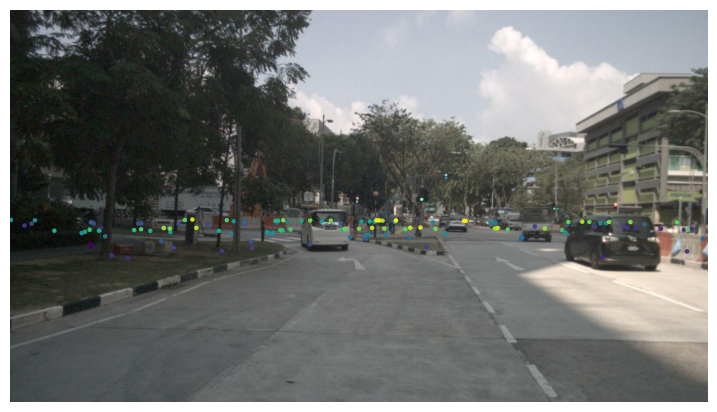

previous_pc  (3, 484)
point xyz (0,)


In [580]:
i = 0
previous_pc = RadarPointCloud.from_file('/media/asus/backup/Nuscenes/data/sets/nuscenes/samples/RADAR_FRONT/n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402927664178.pcd')
# Reading files sequentially
for image_file, pcd_file in zip(image_files, pcd_files):
    image_path = os.path.join(directory, 'CAM_FRONT', image_file)
    pcd_path = os.path.join(directory, 'RADAR_FRONT',pcd_file)

    # Reading image
    image = Image.open(image_path)
    print(image_path)
    # Do something with the image

    # Reading pcd file
    pc = RadarPointCloud.from_file(pcd_path)
    print(pcd_path)
    # Do something with the radar point cloud data

    if i == 0:
        # previous_pc = RadarPointCloud.from_file(pcd_path)
        i+=1
        continue

    process_radar(pc, previous_pc, image)
    # Example: Print filenames
    # print("Image:", image_path)
    # print("PCD:", pcd_path)

    previous_pc = deepcopy(pc)

    # Example: Close the image object
    image.close()
    i+=1
    if i > 6:
        break

In [128]:
def apply_transformation(pc: RadarPointCloud) -> RadarPointCloud:
    cs_record = {'token': 'f4d2a6c281f34a7eb8bb033d82321f79', 'sensor_token': '47fcd48f71d75e0da5c8c1704a9bfe0a', 'translation': [3.412, 0.0, 0.5], 'rotation': [0.9999984769132877, 0.0, 0.0, 0.0017453283658983088], 'camera_intrinsic': []}
    pc.rotate(Quaternion(cs_record['rotation']).rotation_matrix)
    pc.translate(np.array(cs_record['translation']))

    # Second step: transform from ego to the global frame.
    # poserecord = self.nusc.get('ego_pose', pointsensor['ego_pose_token'])
    poserecord1 = {'token': 'b70cefb08263499eb30c7e7da0031428', 'timestamp': 1532402928114656, 'rotation': [0.5742482223921863, -0.00183950588546914, 0.014160690493351492, -0.8185566994058888], 'translation': [409.8439847252494, 1176.9519903782593, 0.0]}
    pc.rotate(Quaternion(poserecord1['rotation']).rotation_matrix)
    pc.translate(np.array(poserecord1['translation']))

    # Third step: transform from global into the ego vehicle frame for the timestamp of the image.
    # poserecord = self.nusc.get('ego_pose', cam['ego_pose_token'])
    poserecord2 = {'token': '4b6870ae200c4b969b91c50a9737f712', 'timestamp': 1532402928112460, 'rotation': [0.5742377826385253, -0.0018667925555496464, 0.014165885989800115, -0.8185638715152707], 'translation': [409.8506686425138, 1176.9702106041582, 0.0]}
    pc.translate(-np.array(poserecord2['translation']))
    pc.rotate(Quaternion(poserecord2['rotation']).rotation_matrix.T)

    # Fourth step: transform from ego into the camera.
    # cs_record = self.nusc.get('calibrated_sensor', cam['calibrated_sensor_token'])
    cs_record = {'token': '1d31c729b073425e8e0202c5c6e66ee1', 'sensor_token': '725903f5b62f56118f4094b46a4470d8', 'translation': [1.70079118954, 0.0159456324149, 1.51095763913], 'rotation': [0.4998015430569128, -0.5030316162024876, 0.4997798114386805, -0.49737083824542755], 'camera_intrinsic': [[1266.417203046554, 0.0, 816.2670197447984], [0.0, 1266.417203046554, 491.50706579294757], [0.0, 0.0, 1.0]]}
    pc.translate(-np.array(cs_record['translation']))
    pc.rotate(Quaternion(cs_record['rotation']).rotation_matrix.T)
    return pc

In [120]:
def calibrate_radar_points(pc: RadarPointCloud, im: Image) -> tuple[np.ndarray, np.ndarray]:
    # Points live in the point sensor frame. So they need to be transformed via global to the image plane.
    # First step: transform the pointcloud to the ego vehicle frame for the timestamp of the sweep.
    # cs_record = self.nusc.get('calibrated_sensor', pointsensor['calibrated_sensor_token'])
    # cs_record = {'token': 'f4d2a6c281f34a7eb8bb033d82321f79', 'sensor_token': '47fcd48f71d75e0da5c8c1704a9bfe0a', 'translation': [3.412, 0.0, 0.5], 'rotation': [0.9999984769132877, 0.0, 0.0, 0.0017453283658983088], 'camera_intrinsic': []}
    # pc.rotate(Quaternion(cs_record['rotation']).rotation_matrix)
    # pc.translate(np.array(cs_record['translation']))

    # # Second step: transform from ego to the global frame.
    # # poserecord = self.nusc.get('ego_pose', pointsensor['ego_pose_token'])
    # poserecord1 = {'token': 'b70cefb08263499eb30c7e7da0031428', 'timestamp': 1532402928114656, 'rotation': [0.5742482223921863, -0.00183950588546914, 0.014160690493351492, -0.8185566994058888], 'translation': [409.8439847252494, 1176.9519903782593, 0.0]}
    # pc.rotate(Quaternion(poserecord1['rotation']).rotation_matrix)
    # pc.translate(np.array(poserecord1['translation']))

    # # Third step: transform from global into the ego vehicle frame for the timestamp of the image.
    # # poserecord = self.nusc.get('ego_pose', cam['ego_pose_token'])
    # poserecord2 = {'token': '4b6870ae200c4b969b91c50a9737f712', 'timestamp': 1532402928112460, 'rotation': [0.5742377826385253, -0.0018667925555496464, 0.014165885989800115, -0.8185638715152707], 'translation': [409.8506686425138, 1176.9702106041582, 0.0]}
    # pc.translate(-np.array(poserecord2['translation']))
    # pc.rotate(Quaternion(poserecord2['rotation']).rotation_matrix.T)

    # Fourth step: transform from ego into the camera.
    # cs_record = self.nusc.get('calibrated_sensor', cam['calibrated_sensor_token'])
    cs_record = {'token': '1d31c729b073425e8e0202c5c6e66ee1', 'sensor_token': '725903f5b62f56118f4094b46a4470d8', 'translation': [1.70079118954, 0.0159456324149, 1.51095763913], 'rotation': [0.4998015430569128, -0.5030316162024876, 0.4997798114386805, -0.49737083824542755], 'camera_intrinsic': [[1266.417203046554, 0.0, 816.2670197447984], [0.0, 1266.417203046554, 491.50706579294757], [0.0, 0.0, 1.0]]}
    # pc.translate(-np.array(cs_record['translation']))
    # pc.rotate(Quaternion(cs_record['rotation']).rotation_matrix.T)

    # Fifth step: actually take a "picture" of the point cloud.
    # Grab the depths (camera frame z axis points away from the camera).
    depths = pc.points[2, :]
    print('depth', depths)
    # retreive the color from depth
    coloring = depths

    # Take the actual picture (matrix multiplication with camera-matrix + renormalization).
    points_with_depth = view_points(pc.points[:3, :], np.array(cs_record['camera_intrinsic']), normalize=False)
    points = view_points(pc.points[:3, :], np.array(cs_record['camera_intrinsic']), normalize=True)
    # print(points.shape)
    # print(points_with_depth.shape)
    # for i in range(10):
    #     print('x: ', int(points.T[i][0]), ' y: ', int(points.T[i][1]), ' z: ', int(points.T[i][2]))

    # print('-----')
    # for i in range(10):
    #     print('x: ', int(points_with_depth.T[i][0]), ' y: ', int(points_with_depth.T[i][1]), ' z: ', int(points_with_depth.T[i][2]))


    # Remove points that are either outside or behind the camera. Leave a margin of 1 pixel for aesthetic reasons.
    # Also make sure points are at least 1m in front of the camera to avoid seeing the lidar points on the camera
    # casing for non-keyframes which are slightly out of sync.
    min_dist : float = 1.0
    dot_size : int = 5
    mask = np.ones(depths.shape[0], dtype=bool)
    mask = np.logical_and(mask, depths > min_dist)
    mask = np.logical_and(mask, points[0, :] > 1)
    mask = np.logical_and(mask, points[0, :] < im.size[0] - 1)
    mask = np.logical_and(mask, points[1, :] > 1)
    mask = np.logical_and(mask, points[1, :] < im.size[1] - 1)
    points = points[:, mask]
    coloring = coloring[mask]
    return points, coloring

earlier prev (18, 49)
earlier cur (18, 61)
Estimated number of clusters: 21
Estimated number of nose points: 65
z_avg :  21.525664694346517
z_avg :  16.70476832897831
z_avg :  22.914391969118576
z_avg :  30.58520857889508
z_avg :  40.31104724423368
z_avg :  37.2879007385496
z_avg :  49.28803654918873
z_avg :  46.40828612648314
z_avg :  59.9920349065476
z_avg :  58.51196213286555
z_avg :  64.26295089697825
z_avg :  73.40650113875338
z_avg :  75.60689868854642
z_avg :  84.35222481520645
z_avg :  84.50933178761005
z_avg :  90.97805965157448
z_avg :  86.44185916934498
z_avg :  95.79501230971476
z_avg :  100.7138531699868
z_avg :  104.25143091922843
z_avg :  110.85390626615853
dets np shape (21, 4)
value of h is  0.20000000000000284
value of h is  0.20000000000000284
value of h is  0.20000000000000284
value of h is  0.20000000000000284
value of h is  0.20000000000000284
value of h is  0.20000000000000284
value of h is  0.20000000000000284
value of h is  0.20000000000000284
value of h is  0.

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:88: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_21243/3264947301.py:72: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")
/tmp/ipykernel_21243/3264947301.py:79: RuntimeWarning: invalid value encountered in cast
  d = d.astype(np.int32)


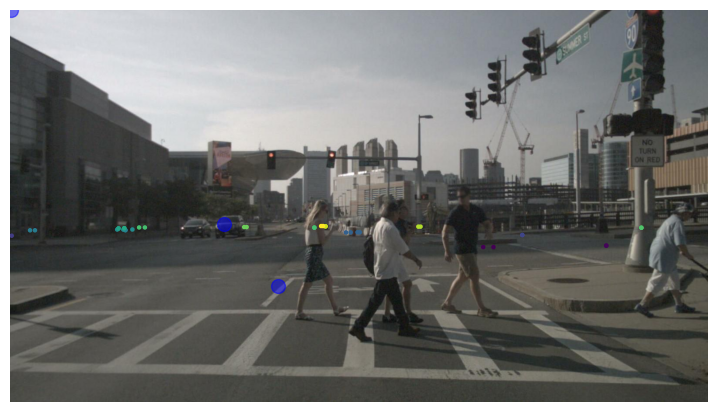

previous_pc  (3, 45)
point xyz (0,)
earlier prev (18, 61)
earlier cur (18, 61)
Estimated number of clusters: 28
Estimated number of nose points: 64
z_avg :  21.525664694346517
z_avg :  22.914391969118576
z_avg :  30.685207156575146
z_avg :  37.38768108324849
z_avg :  48.93901690570068
z_avg :  48.75784019128889
z_avg :  46.40806979875307
z_avg :  59.9920349065476
z_avg :  58.61174438281566
z_avg :  64.44692996773678
z_avg :  70.39579636445707
z_avg :  75.60689868854642
z_avg :  84.41019661353576
z_avg :  91.7505747575515
z_avg :  91.07784381090183
z_avg :  86.2409967071909
z_avg :  95.27749884438967
z_avg :  95.79501230971476
z_avg :  72.94506998996262
z_avg :  84.8472402765541
z_avg :  90.9484228665473
z_avg :  100.41407567095925
z_avg :  104.25121459201421
z_avg :  110.95325777002586
z_avg :  179.9606624225046
z_avg :  225.76827609015714
z_avg :  94.45506968313634
z_avg :  96.73599066556005
dets np shape (28, 4)
value of h is  0.20000000000000284
value of h is  0.20000000000000284
va

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:88: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_21243/3264947301.py:72: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


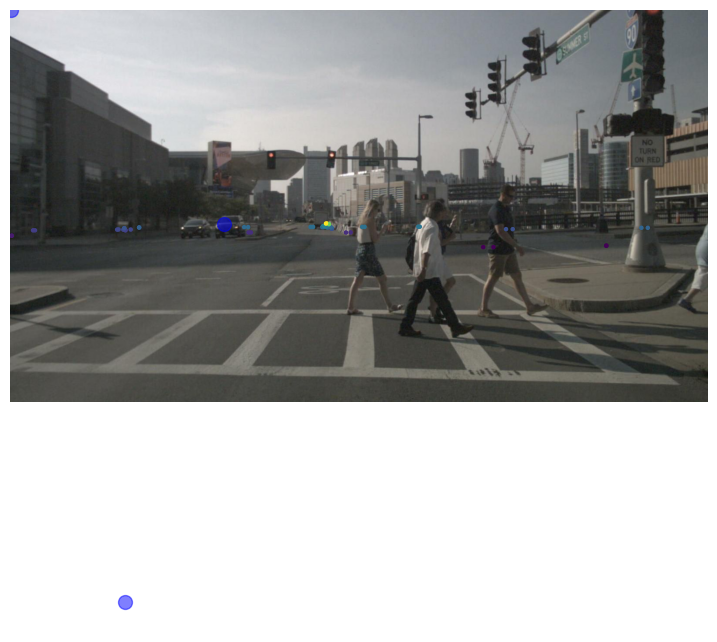

previous_pc  (3, 58)
point xyz (0,)
earlier prev (18, 61)
earlier cur (18, 65)
Estimated number of clusters: 33
Estimated number of nose points: 57
z_avg :  30.685207156575146
z_avg :  37.38768108324849
z_avg :  48.757623864590514
z_avg :  46.30828945611713
z_avg :  54.20598521408143
z_avg :  59.9920349065476
z_avg :  58.61196071054573
z_avg :  64.59454633119636
z_avg :  65.29842835027826
z_avg :  59.61929778665532
z_avg :  70.39579636445707
z_avg :  72.09506002861514
z_avg :  75.60689868854642
z_avg :  91.39917456424098
z_avg :  91.07741115750486
z_avg :  94.45506968313634
z_avg :  96.73599066556001
z_avg :  95.17771469125151
z_avg :  95.7952286333186
z_avg :  72.94506998996262
z_avg :  84.54703012412959
z_avg :  104.65164155664718
z_avg :  111.15282227198901
z_avg :  119.95179746938524
z_avg :  127.05491277852843
z_avg :  143.65959115755564
z_avg :  173.13721002420183
z_avg :  180.05957745834655
z_avg :  183.2339977396747
z_avg :  199.23414178821423
z_avg :  205.88247843815927
z_avg 

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:88: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_21243/3264947301.py:72: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


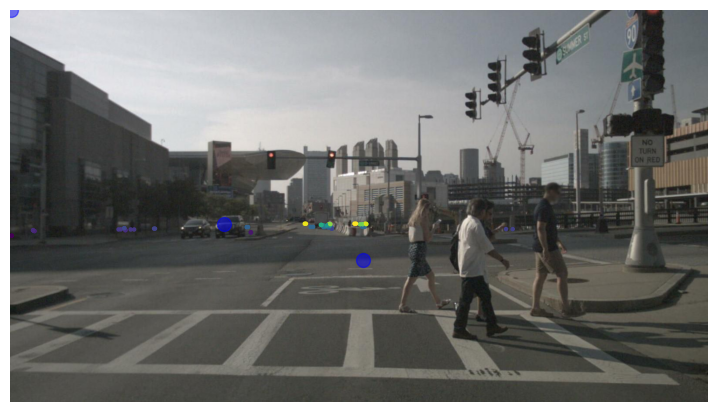

previous_pc  (3, 69)
point xyz (0,)
earlier prev (18, 65)
earlier cur (18, 66)
Estimated number of clusters: 34
Estimated number of nose points: 59
z_avg :  16.580325288505
z_avg :  30.585424906625043
z_avg :  40.21018526707386
z_avg :  37.18833481632946
z_avg :  48.73966873095174
z_avg :  48.757623864590514
z_avg :  46.208725441211264
z_avg :  58.53213608273181
z_avg :  54.20620154181139
z_avg :  59.9920349065476
z_avg :  58.61196071054573
z_avg :  70.29536322606575
z_avg :  71.59463639413201
z_avg :  75.60689868854642
z_avg :  91.39917456424098
z_avg :  91.07762748317175
z_avg :  92.977537287943
z_avg :  94.9781501913514
z_avg :  95.6954482948089
z_avg :  127.08195364059497
z_avg :  49.23728011616261
z_avg :  62.14310420021033
z_avg :  72.94506998996262
z_avg :  79.93693963010378
z_avg :  85.08136285412355
z_avg :  96.735846447659
z_avg :  104.85271653190277
z_avg :  111.25281894235489
z_avg :  127.25426095276153
z_avg :  173.2363413870002
z_avg :  180.1595741287124
z_avg :  183.2335

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:88: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_21243/3264947301.py:72: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


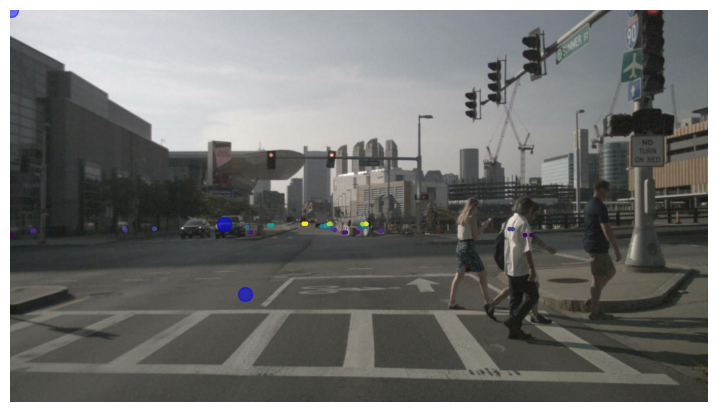

previous_pc  (3, 72)
point xyz (0,)
earlier prev (18, 66)
earlier cur (18, 58)
Estimated number of clusters: 35
Estimated number of nose points: 51
z_avg :  21.32588577351489
z_avg :  30.685207158638093
z_avg :  40.21126690159777
z_avg :  36.988988549410436
z_avg :  48.73988505777911
z_avg :  48.757623864590514
z_avg :  46.30872211157716
z_avg :  54.20620154181139
z_avg :  59.99225123427756
z_avg :  58.61196071054573
z_avg :  64.1952029089172
z_avg :  70.29557955379582
z_avg :  75.50711453128216
z_avg :  81.08111022041771
z_avg :  85.41469017484768
z_avg :  84.31019993904386
z_avg :  91.85013877400468
z_avg :  91.07784381090171
z_avg :  96.73577433868833
z_avg :  93.17688545598702
z_avg :  95.69523197120505
z_avg :  61.74289546984788
z_avg :  72.84507331959674
z_avg :  79.93693963010378
z_avg :  90.84842619669726
z_avg :  100.51364350255653
z_avg :  104.95271320226854
z_avg :  126.95405080033703
z_avg :  134.00329689432274
z_avg :  136.5582064640633
z_avg :  173.13612076042108
z_avg : 

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:88: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_21243/3264947301.py:72: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


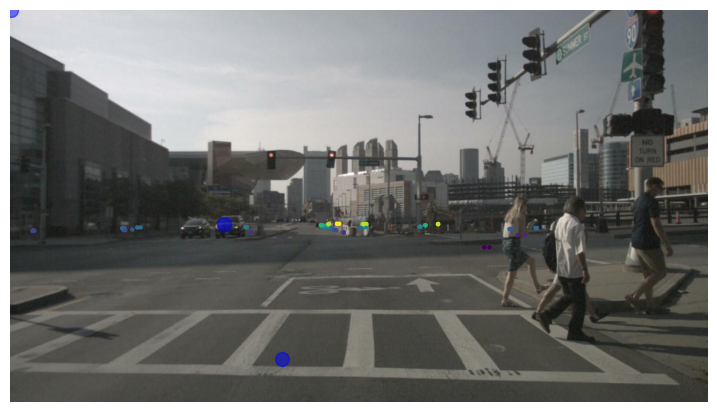

previous_pc  (3, 73)
point xyz (0,)
earlier prev (18, 58)
earlier cur (18, 59)
Estimated number of clusters: 39
Estimated number of nose points: 35
z_avg :  21.326102100213383
z_avg :  40.337655453934744
z_avg :  40.211483228296245
z_avg :  37.08877079936053
z_avg :  48.73988505777911
z_avg :  48.757623864590514
z_avg :  46.40871878194306
z_avg :  54.20620154181139
z_avg :  59.992467562007526
z_avg :  58.51217846059562
z_avg :  64.39476741088036
z_avg :  59.81907861841161
z_avg :  70.29557955379582
z_avg :  75.50711453128216
z_avg :  81.08132654814779
z_avg :  85.54874079412284
z_avg :  84.50933178761017
z_avg :  91.84970612009195
z_avg :  90.97784332590747
z_avg :  96.7363151559301
z_avg :  93.07732144108117
z_avg :  95.69523197120505
z_avg :  91.34549970120084
z_avg :  61.642896892167805
z_avg :  72.84507331959674
z_avg :  80.03694011509813
z_avg :  90.94842286706304
z_avg :  100.61364017292243
z_avg :  104.8520675518073
z_avg :  134.00308056762435
z_avg :  136.15821215334302
z_avg :

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:88: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_21243/3264947301.py:72: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


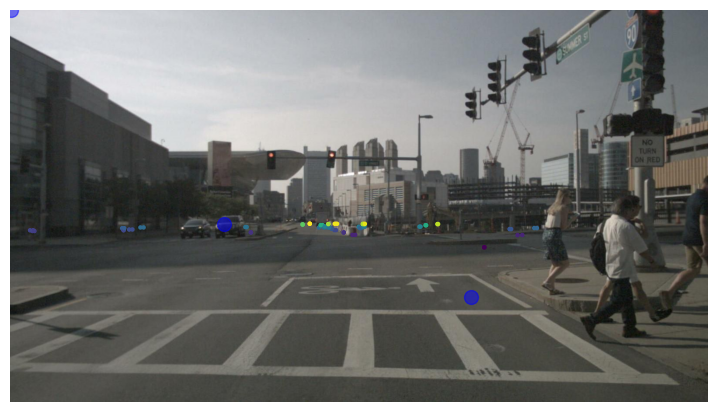

previous_pc  (3, 82)
point xyz (0,)
earlier prev (18, 59)
earlier cur (18, 61)
Estimated number of clusters: 38
Estimated number of nose points: 40
z_avg :  21.326102100213383
z_avg :  40.31104724423368
z_avg :  37.1887693770406
z_avg :  48.73988505777911
z_avg :  48.757623864590514
z_avg :  46.30893843518112
z_avg :  54.20620154181139
z_avg :  59.99225123427756
z_avg :  58.412396210645504
z_avg :  64.29498516093037
z_avg :  60.01864311831172
z_avg :  70.29579587946272
z_avg :  74.68230577118798
z_avg :  75.60689868854642
z_avg :  85.68134796248995
z_avg :  84.50933178761017
z_avg :  91.94948646324352
z_avg :  90.97805965157448
z_avg :  96.68664131108503
z_avg :  92.977537287943
z_avg :  95.89479265647671
z_avg :  127.28130181482808
z_avg :  61.409351822167515
z_avg :  72.94485366326413
z_avg :  79.93672711784043
z_avg :  90.94842286706304
z_avg :  100.61364017292243
z_avg :  104.75142190031447
z_avg :  111.55281658270928
z_avg :  134.10286091129174
z_avg :  135.9590764901484
z_avg :  

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:88: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_21243/3264947301.py:72: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


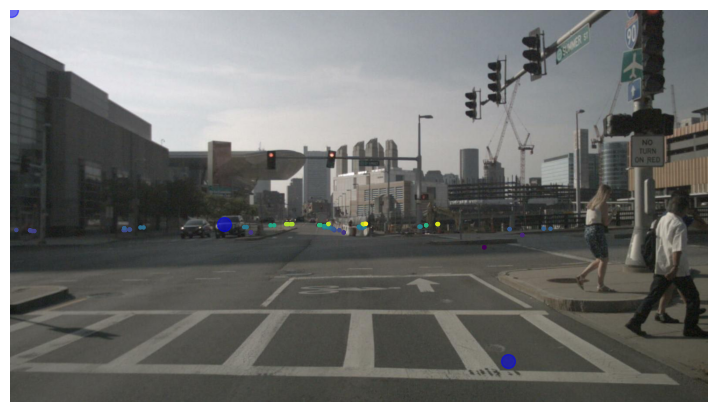

previous_pc  (3, 80)
point xyz (0,)
earlier prev (18, 61)
earlier cur (18, 62)
Estimated number of clusters: 45
Estimated number of nose points: 29
z_avg :  21.326102100213383
z_avg :  23.014822246538472
z_avg :  40.31104724423368
z_avg :  37.1887693770406
z_avg :  48.73988505777911
z_avg :  48.757623864590514
z_avg :  51.6389670593061
z_avg :  46.20915808841917
z_avg :  61.29203846990537
z_avg :  54.20598521408143
z_avg :  59.9920349065476
z_avg :  58.41217988291555
z_avg :  64.39519815696316
z_avg :  70.29536322606575
z_avg :  74.48123079593242
z_avg :  75.60689868854642
z_avg :  85.5506896432706
z_avg :  85.49546882870142
z_avg :  84.50911545988009
z_avg :  91.94991911715624
z_avg :  90.97827597930444
z_avg :  96.63642664897799
z_avg :  91.4239152656964
z_avg :  93.27666580274897
z_avg :  95.37706285929553
z_avg :  95.79522481869016
z_avg :  49.237496443118964
z_avg :  72.94485366326413
z_avg :  79.73651363552393
z_avg :  85.7474380809463
z_avg :  90.94842286706304
z_avg :  98.54634

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:88: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_21243/3264947301.py:72: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


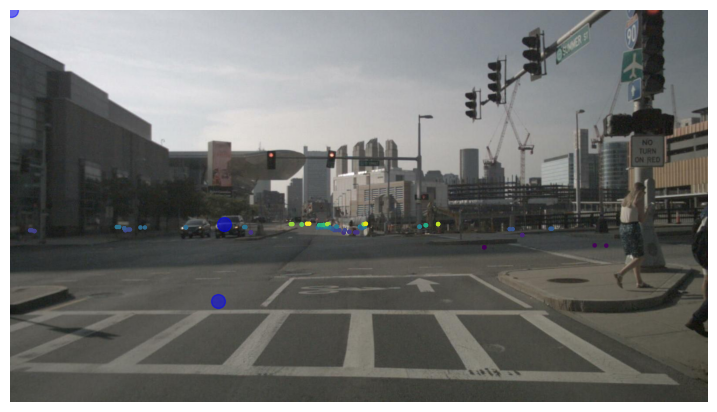

previous_pc  (3, 94)
point xyz (0,)
earlier prev (18, 62)
earlier cur (18, 66)
Estimated number of clusters: 44
Estimated number of nose points: 39
z_avg :  21.326102100213383
z_avg :  20.562890959900205
z_avg :  23.01460591983998
z_avg :  30.285863734295987
z_avg :  40.337871780891106
z_avg :  40.31104724423368
z_avg :  37.188336721580676
z_avg :  48.73988505777911
z_avg :  48.757407537892036
z_avg :  51.73939829064101
z_avg :  46.20915808841917
z_avg :  54.20598521408143
z_avg :  59.99225123427756
z_avg :  58.51196213286566
z_avg :  64.39606346375712
z_avg :  72.09354574069414
z_avg :  74.58166012175822
z_avg :  75.60689868854642
z_avg :  80.98002810089946
z_avg :  84.50933178761005
z_avg :  91.84992244679036
z_avg :  91.0780601386318
z_avg :  96.8028018734842
z_avg :  86.44142270338263
z_avg :  91.32413492306057
z_avg :  93.47623030264907
z_avg :  95.6956608037843
z_avg :  61.942892625208124
z_avg :  72.94506998996262
z_avg :  79.83672663278165
z_avg :  85.64744141058051
z_avg :  90

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:88: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_21243/3264947301.py:72: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


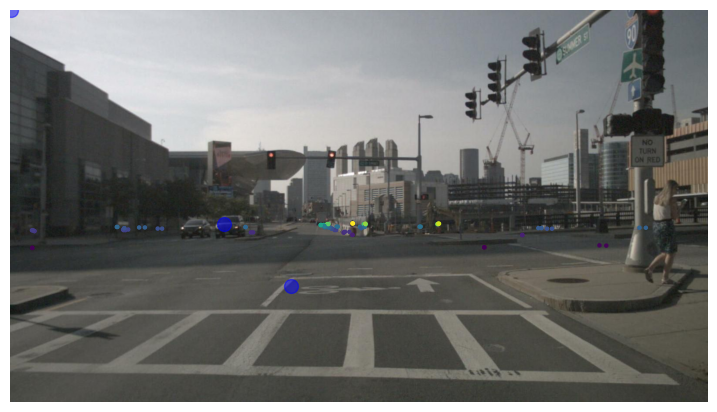

previous_pc  (3, 89)
point xyz (0,)
earlier prev (18, 66)
earlier cur (18, 63)
Estimated number of clusters: 40
Estimated number of nose points: 48
z_avg :  21.42609972423631
z_avg :  23.114819870561384
z_avg :  30.58520857889508
z_avg :  40.337871780891106
z_avg :  40.31104724423368
z_avg :  37.188336721580676
z_avg :  48.73988505777911
z_avg :  48.757407537892036
z_avg :  51.73983094429585
z_avg :  54.30598188444722
z_avg :  59.99225123427756
z_avg :  58.61196071054573
z_avg :  70.6124506921045
z_avg :  71.99203478240749
z_avg :  74.7829514226807
z_avg :  75.60689868854642
z_avg :  80.98002810089946
z_avg :  84.50976444307008
z_avg :  91.84948979287765
z_avg :  91.0780601386318
z_avg :  91.42327010126098
z_avg :  93.2768821263528
z_avg :  95.79522864157084
z_avg :  57.62458125631434
z_avg :  58.13647212467131
z_avg :  62.04310752984455
z_avg :  72.94506998996262
z_avg :  79.93650697625563
z_avg :  85.74743808094641
z_avg :  96.80309030938297
z_avg :  99.14611626538182
z_avg :  100.51

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:88: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_21243/3264947301.py:72: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


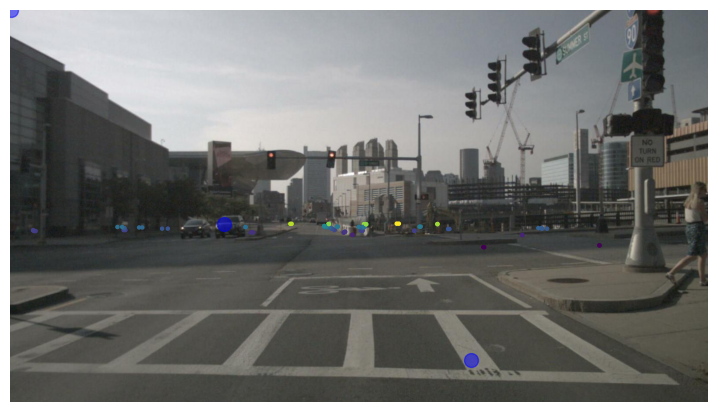

previous_pc  (3, 81)
point xyz (0,)
earlier prev (18, 63)
earlier cur (18, 60)
Estimated number of clusters: 4
Estimated number of nose points: 115
z_avg :  96.63685930282617
z_avg :  61.942676298251776
z_avg :  194.59090726802464
z_avg :  7.35469297729389
dets np shape (4, 4)
value of h is  0.19999999999998863
value of h is  0.20000000000000284
value of h is  0.19999999999998863
value of h is  0.1999999999999993
len of trackers 3
depth [ 96.53772794  61.94310895  96.73599067 194.39134658 194.79046796
   6.95534908   7.75403688  61.94224364]
traker data  -53.31475186678921 194.49090726802464 -52.51302039249393 194.69090726802463 2385.0
traker data  -7.040352479597943 61.828851544075704 -6.337607620070199 62.056501063240674 2346.0
traker data  -2.6419479245533894 96.52441680527319 -0.8469435561152759 96.73939200504095 2172.0
tracker shape (3, 3)
tracker np [[-52.5   0.  194. ]
 [ -6.5   0.   61.5]
 [ -1.    0.   96. ]]
mask shape (3,)  tracker_points shape (3, 3)
values shape (3,)
track

/home/asus/zzzzz/ros2/acceleration_robotics/research_thesis/colcon_ws/src/carla-multi-sensor-fusion/deepsort_tracking/deepsort_tracking/sort.py:88: RuntimeWarning: invalid value encountered in divide
  h = x[2] / w
/tmp/ipykernel_21243/3264947301.py:72: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("sample token")


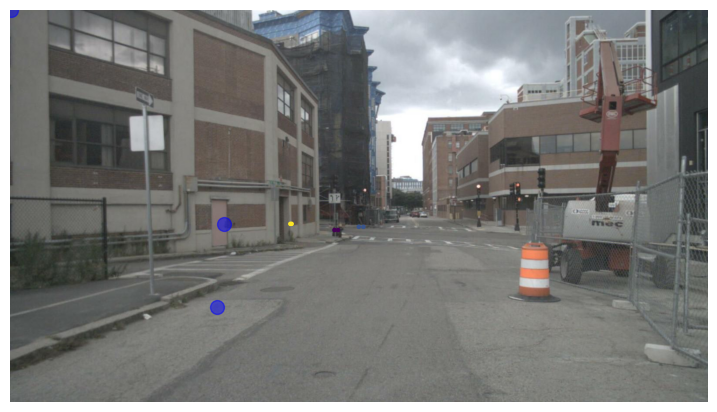

previous_pc  (3, 8)
point xyz (0,)


In [145]:
i = 0
dbscan = DBSCAN(eps=1, min_samples=2)
# instance of sort
mot_tracker = Sort(max_age=5, min_hits=1, iou_threshold=0.1)

for current_index in range(150, len(image_files) - 1):
    current_image_file = image_files[current_index]
    current_pcd_file = pcd_files[current_index]
    
    next_image_file = image_files[current_index + 1]
    next_pcd_file = pcd_files[current_index + 1]
    
    current_image_path = os.path.join(directory, 'CAM_FRONT', current_image_file)
    current_pcd_path = os.path.join(directory, 'RADAR_FRONT', current_pcd_file)
    
    next_image_path = os.path.join(directory, 'CAM_FRONT', next_image_file)
    next_pcd_path = os.path.join(directory, 'RADAR_FRONT', next_pcd_file)
    
    # Read current frame image
    current_image = Image.open(current_image_path)
    
    # Read current frame PCD
    current_pcd = apply_transformation(RadarPointCloud.from_file(current_pcd_path))
    
    # Read next frame image
    next_image = Image.open(next_image_path)
    
    # Read next frame PCD
    next_pcd = apply_transformation(RadarPointCloud.from_file(next_pcd_path))
    # print(next_pcd.points[2,:])

    process_radar(next_pcd, current_pcd, next_image)

    i+=1
    if i > 10:
        break

In [17]:
dets_np

NameError: name 'dets_np' is not defined